<a href="https://colab.research.google.com/github/johnnyff/LG_AIMERS/blob/main/Aimers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive

drive.mount('/content/gdrive')



Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [2]:
import pandas as pd
import random
import os
import numpy as np
!pip install catboost
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance
from sklearn.model_selection import train_test_split
import catboost
from sklearn.metrics import mean_squared_error

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
seed_everything(1422) # Seed 고정

In [4]:
base= '/content/gdrive/MyDrive/antena/data/'

train_df = pd.read_csv(base+'train.csv')

In [5]:
train_x = train_df.filter(regex='X') # Input : X Featrue
train_y = train_df.filter(regex='Y') # Output : Y Feature

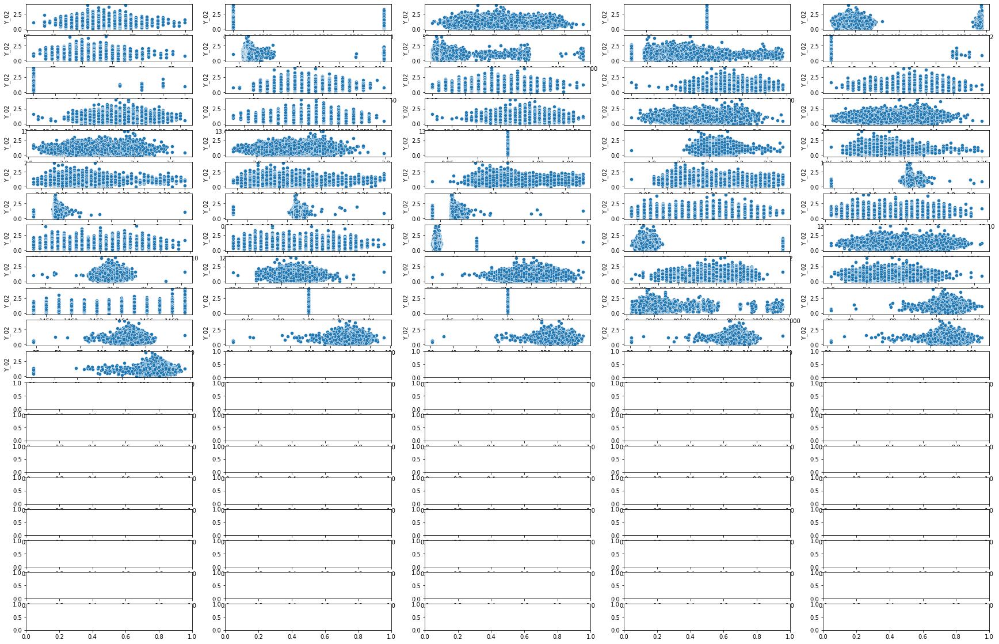

In [86]:
import seaborn as sns
fig, ax = plt.subplots(20, 5, figsize=(30, 20))
for var, subplot in zip(train_x.columns, ax.flatten()):
    sns.scatterplot(x=var, y=train_y['Y_02'], data=train_x, ax=subplot)

In [15]:
train_df['is_error'] = "N"
train_df['is_error'][[0, 6, 9, 12, 14, 23, 33, 35, 37, 60, 67, 70, 72, 74, 76, 86, 98, 105, 120, 135, 137, 138, 140, 142, 144, 145, 147, 169, 177, 183, 186, 187, 201, 205, 207, 219, 222, 223, 226, 239, 240, 246, 253, 264, 267, 270, 275, 292, 299, 305, 315, 322, 328, 332, 333, 344, 345, 347, 353, 354, 355, 356, 357, 361, 364, 365, 367, 386, 396, 403, 406, 408, 410, 414, 415, 418, 425, 435, 440, 448, 451, 453, 454, 455, 458, 465, 469, 476, 484, 485, 494, 505, 531, 536, 537, 543, 555, 557, 576, 580, 593, 597, 599, 603, 610, 628, 638, 655, 656, 671, 672, 682, 683, 688, 689, 699, 711, 722, 730, 736, 746, 764, 765, 773, 778, 783, 787, 788, 796, 827, 833, 834, 864, 876, 881, 882, 885, 892, 910, 915, 921, 924, 927, 929, 930, 931, 932, 933, 938, 942, 943, 949, 951, 956, 957, 958, 967, 969, 970, 971, 972, 973, 976, 977, 979, 995, 999, 1020, 1031, 1032, 1043, 1045, 1050, 1053, 1064, 1074, 1078, 1082, 1084, 1091, 1104, 1106, 1107, 1108, 1116, 1123, 1127, 1131, 1140, 1144, 1145, 1153, 1154, 1167, 1189, 1208, 1220, 1232, 1248, 1263, 1267, 1273, 1283, 1286, 1287, 1295, 1311, 1312, 1327, 1328, 1346, 1356, 1358, 1366, 1371, 1372, 1379, 1386, 1390, 1397, 1398, 1421, 1422, 1425, 1426, 1435, 1436, 1453, 1458, 1459, 1462, 1471, 1476, 1479, 1485, 1491, 1500, 1503, 1504, 1505, 1519, 1521, 1545, 1575, 1588, 1603, 1609, 1636, 1637, 1645, 1649, 1657, 1659, 1663, 1683, 1706, 1707, 1725, 1741, 1784, 1819, 1832, 1849, 1854, 1855, 1859, 1872, 1960, 1961, 1963, 1971, 1984, 2007, 2014, 2048, 2068, 2081, 2083, 2085, 2100, 2128, 2145, 2157, 2166, 2170, 2215, 2228, 2231, 2236, 2263, 2307, 2319, 2334, 2361, 2363, 2367, 2374, 2378, 2379, 2382, 2385, 2394, 2395, 2407, 2420, 2430, 2436, 2460, 2465, 2476, 2493, 2500, 2555, 2560, 2578, 2584, 2606, 2618, 2621, 2623, 2625, 2635, 2669, 2675, 2680, 2683, 2685, 2687, 2699, 2705, 2714, 2715, 2717, 2736, 2748, 2754, 2767, 2777, 2791, 2795, 2796, 2797, 2800, 2803, 2806, 2808, 2816, 2827, 2831, 2832, 2833, 2841, 2848, 2858, 2869, 2877, 2880, 2886, 2887, 2895, 2910, 2916, 2918, 2928, 2940, 2947, 2948, 2953, 2959, 2960, 2961, 2964, 2977, 2978, 2980, 2993, 3005, 3013, 3014, 3022, 3026, 3031, 3038, 3055, 3057, 3060, 3070, 3077, 3084, 3087, 3111, 3112, 3121, 3130, 3164, 3172, 3176, 3177, 3178, 3182, 3183, 3193, 3196, 3201, 3217, 3229, 3249, 3251, 3253, 3254, 3262, 3276, 3291, 3299, 3306, 3317, 3341, 3347, 3348, 3356, 3363, 3373, 3374, 3385, 3388, 3391, 3402, 3404, 3415, 3427, 3453, 3454, 3456, 3464, 3492, 3497, 3504, 3523, 3570, 3579, 3607, 3626, 3640, 3643, 3653, 3663, 3702, 3714, 3722, 3724, 3744, 3754, 3768, 3771, 3777, 3778, 3790, 3817, 3839, 3841, 3856, 3859, 3862, 3921, 3934, 3942, 3944, 3947, 3961, 3962, 3965, 3966, 3975, 3979, 3982, 3990, 3994, 4018, 4036, 4058, 4066, 4108, 4109, 4118, 4128, 4144, 4150, 4151, 4153, 4165, 4172, 4207, 4215, 4251, 4258, 4259, 4263, 4264, 4268, 4272, 4301, 4316, 4317, 4321, 4327, 4330, 4357, 4383, 4399, 4405, 4413, 4419, 4438, 4457, 4464, 4467, 4516, 4533, 4535, 4549, 4574, 4580, 4583, 4584, 4603, 4628, 4630, 4636, 4638, 4644, 4659, 4669, 4676, 4680, 4684, 4688, 4696, 4697, 4707, 4715, 4717, 4720, 4728, 4730, 4762, 4769, 4777, 4779, 4791, 4793, 4796, 4805, 4808, 4832, 4834, 4836, 4838, 4846, 4863, 4869, 4877, 4879, 4880, 4882, 4883, 4885, 4893, 4901, 4902, 4914, 4916, 4920, 4925, 4930, 4938, 4950, 4953, 4959, 4960, 4975, 4987, 4990, 4991, 5019, 5034, 5038, 5039, 5040, 5042, 5043, 5044, 5048, 5051, 5053, 5061, 5066, 5075, 5077, 5092, 5099, 5104, 5108, 5119, 5125, 5131, 5133, 5134, 5137, 5138, 5144, 5176, 5185, 5188, 5193, 5195, 5200, 5210, 5212, 5218, 5252, 5256, 5262, 5272, 5286, 5294, 5295, 5296, 5297, 5303, 5306, 5317, 5326, 5331, 5332, 5361, 5364, 5388, 5397, 5398, 5401, 5404, 5406, 5410, 5419, 5420, 5430, 5471, 5476, 5477, 5484, 5494, 5498, 5499, 5508, 5515, 5518, 5532, 5539, 5540, 5541, 5543, 5547, 5576, 5577, 5578, 5598, 5599, 5600, 5601, 5603, 5604, 5606, 5610, 5626, 5628, 5639, 5640, 5642, 5643, 5644, 5645, 5649, 5650, 5651, 5652, 5653, 5655, 5656, 5660, 5661, 5668, 5706, 5708, 5720, 5729, 5773, 5775, 5783, 5787, 5797, 5810, 5812, 5816, 5823, 5829, 5842, 5857, 5890, 5892, 5905, 5933, 5940, 5943, 5949, 5968, 5970, 5979, 6009, 6017, 6028, 6047, 6049, 6050, 6062, 6088, 6103, 6111, 6114, 6141, 6163, 6169, 6173, 6178, 6187, 6206, 6219, 6237, 6239, 6264, 6271, 6276, 6279, 6286, 6309, 6317, 6318, 6341, 6342, 6350, 6353, 6356, 6364, 6367, 6371, 6378, 6387, 6397, 6411, 6422, 6436, 6478, 6486, 6489, 6550, 6559, 6562, 6568, 6576, 6585, 6586, 6622, 6654, 6656, 6657, 6711, 6716, 6727, 6764, 6786, 6790, 6794, 6796, 6806, 6813, 6816, 6847, 6866, 6868, 6871, 6876, 6878, 6934, 6938, 6965, 6983, 6986, 6991, 6993, 6998, 6999, 7026, 7028, 7029, 7031, 7049, 7054, 7089, 7090, 7094, 7095, 7096, 7107, 7109, 7116, 7134, 7137, 7141, 7146, 7150, 7161, 7186, 7188, 7195, 7202, 7207, 7208, 7210, 7211, 7233, 7247, 7255, 7258, 7262, 7264, 7271, 7279, 7287, 7289, 7299, 7325, 7331, 7336, 7353, 7355, 7358, 7359, 7370, 7379, 7402, 7403, 7405, 7411, 7413, 7435, 7436, 7440, 7441, 7442, 7443, 7444, 7446, 7447, 7451, 7455, 7457, 7465, 7466, 7473, 7475, 7482, 7494, 7497, 7501, 7505, 7507, 7511, 7517, 7528, 7541, 7558, 7582, 7583, 7587, 7612, 7620, 7625, 7629, 7631, 7657, 7660, 7665, 7690, 7733, 7737, 7741, 7743, 7746, 7749, 7762, 7768, 7772, 7773, 7780, 7793, 7797, 7812, 7825, 7831, 7833, 7835, 7843, 7844, 7845, 7846, 7853, 7856, 7859, 7894, 7895, 7903, 7905, 7907, 7909, 7910, 7912, 7914, 7917, 7920, 7925, 7926, 7943, 7945, 7946, 7955, 7961, 7965, 7968, 7980, 7981, 7983, 7987, 7997, 7999, 8010, 8012, 8019, 8030, 8037, 8050, 8055, 8060, 8064, 8069, 8085, 8090, 8103, 8109, 8112, 8127, 8170, 8183, 8216, 8217, 8231, 8242, 8251, 8276, 8298, 8302, 8304, 8318, 8328, 8329, 8353, 8361, 8370, 8390, 8393, 8401, 8405, 8408, 8411, 8439, 8445, 8452, 8454, 8458, 8466, 8468, 8469, 8483, 8489, 8498, 8499, 8512, 8523, 8525, 8554, 8562, 8565, 8587, 8588, 8599, 8600, 8602, 8608, 8615, 8621, 8636, 8658, 8674, 8691, 8707, 8715, 8733, 8736, 8739, 8758, 8761, 8774, 8788, 8792, 8794, 8796, 8811, 8823, 8830, 8838, 8928, 8945, 8947, 8952, 8969, 8984, 9029, 9052, 9095, 9097, 9145, 9147, 9151, 9163, 9170, 9200, 9214, 9218, 9229, 9247, 9250, 9259, 9291, 9297, 9302, 9303, 9317, 9318, 9323, 9324, 9327, 9330, 9336, 9363, 9369, 9374, 9389, 9390, 9394, 9395, 9416, 9431, 9448, 9450, 9471, 9485, 9488, 9494, 9502, 9503, 9504, 9507, 9526, 9529, 9545, 9553, 9591, 9625, 9627, 9640, 9644, 9645, 9648, 9653, 9654, 9655, 9658, 9659, 9662, 9665, 9671, 9700, 9707, 9718, 9727, 9729, 9733, 9740, 9741, 9757, 9758, 9760, 9762, 9782, 9796, 9801, 9805, 9826, 9834, 9840, 9842, 9845, 9850, 9851, 9852, 9869, 9888, 9890, 9901, 9902, 9905, 9908, 9940, 9951, 9965, 9968, 9969, 9973, 9982, 9983, 9989, 9999, 10000, 10007, 10008, 10040, 10043, 10050, 10065, 10068, 10082, 10121, 10122, 10127, 10129, 10136, 10149, 10161, 10178, 10182, 10189, 10193, 10203, 10229, 10253, 10254, 10255, 10257, 10260, 10263, 10267, 10273, 10278, 10280, 10282, 10283, 10284, 10285, 10286, 10288, 10289, 10292, 10307, 10316, 10330, 10332, 10341, 10357, 10373, 10379, 10380, 10386, 10388, 10390, 10392, 10398, 10406, 10413, 10420, 10436, 10438, 10440, 10444, 10460, 10470, 10490, 10493, 10501, 10510, 10527, 10546, 10568, 10582, 10583, 10591, 10596, 10598, 10599, 10623, 10638, 10643, 10646, 10693, 10740, 10748, 10763, 10767, 10785, 10792, 10796, 10816, 10823, 10832, 10833, 10842, 10846, 10848, 10855, 10895, 10907, 10929, 10935, 10936, 10947, 10955, 10985, 10987, 10989, 11020, 11044, 11045, 11046, 11051, 11073, 11075, 11096, 11119, 11135, 11148, 11154, 11167, 11169, 11196, 11214, 11233, 11265, 11275, 11300, 11321, 11375, 11376, 11380, 11412, 11442, 11468, 11494, 11503, 11508, 11516, 11519, 11588, 11589, 11594, 11621, 11626, 11627, 11632, 11642, 11646, 11647, 11662, 11664, 11687, 11695, 11703, 11731, 11732, 11735, 11737, 11743, 11748, 11754, 11769, 11772, 11786, 11793, 11796, 11806, 11820, 11822, 11825, 11828, 11840, 11845, 11862, 11866, 11872, 11877, 11882, 11887, 11892, 11903, 11915, 11927, 11929, 11939, 11947, 11968, 11970, 11996, 11997, 12006, 12008, 12010, 12011, 12016, 12019, 12027, 12035, 12038, 12043, 12046, 12050, 12074, 12083, 12091, 12093, 12094, 12096, 12098, 12104, 12121, 12130, 12135, 12137, 12145, 12166, 12168, 12181, 12190, 12198, 12204, 12217, 12221, 12258, 12272, 12273, 12283, 12309, 12319, 12322, 12323, 12354, 12359, 12363, 12373, 12374, 12378, 12384, 12386, 12394, 12405, 12406, 12428, 12433, 12434, 12450, 12453, 12455, 12490, 12499, 12500, 12504, 12508, 12510, 12531, 12535, 12544, 12547, 12548, 12554, 12569, 12583, 12603, 12604, 12605, 12606, 12607, 12609, 12612, 12615, 12616, 12617, 12618, 12625, 12627, 12629, 12630, 12653, 12654, 12655, 12659, 12661, 12663, 12677, 12679, 12719, 12730, 12750, 12761, 12769, 12784, 12812, 12871, 12872, 12877, 12911, 12949, 12964, 12983, 13020, 13046, 13047, 13050, 13056, 13066, 13068, 13089, 13098, 13104, 13111, 13141, 13159, 13172, 13174, 13184, 13192, 13210, 13219, 13224, 13228, 13230, 13235, 13258, 13259, 13267, 13278, 13280, 13306, 13311, 13312, 13313, 13321, 13324, 13330, 13339, 13358, 13367, 13368, 13369, 13373, 13374, 13376, 13392, 13407, 13411, 13437, 13438, 13445, 13451, 13452, 13456, 13475, 13476, 13503, 13507, 13517, 13525, 13537, 13551, 13556, 13578, 13584, 13614, 13627, 13645, 13683, 13684, 13686, 13700, 13754, 13759, 13798, 13849, 13894, 13920, 13923, 13960, 13962, 13987, 14010, 14019, 14021, 14031, 14049, 14067, 14077, 14101, 14114, 14129, 14165, 14172, 14236, 14246, 14250, 14280, 14301, 14328, 14329, 14356, 14383, 14387, 14398, 14410, 14418, 14423, 14440, 14443, 14444, 14453, 14460, 14462, 14487, 14488, 14499, 14502, 14504, 14517, 14530, 14535, 14536, 14558, 14566, 14584, 14588, 14593, 14615, 14622, 14629, 14632, 14636, 14651, 14652, 14673, 14674, 14678, 14684, 14701, 14705, 14712, 14719, 14724, 14735, 14739, 14767, 14782, 14788, 14803, 14818, 14824, 14833, 14840, 14844, 14854, 14857, 14868, 14885, 14911, 14915, 14916, 14924, 14929, 14931, 14933, 14935, 14940, 14945, 14974, 14976, 14984, 14995, 15013, 15014, 15025, 15028, 15034, 15036, 15045, 15051, 15062, 15064, 15082, 15084, 15100, 15120, 15130, 15138, 15147, 15154, 15158, 15178, 15181, 15193, 15194, 15198, 15204, 15209, 15210, 15241, 15246, 15248, 15252, 15253, 15281, 15287, 15289, 15308, 15330, 15332, 15334, 15335, 15336, 15339, 15347, 15351, 15352, 15357, 15359, 15363, 15365, 15367, 15371, 15375, 15382, 15383, 15399, 15414, 15424, 15427, 15428, 15431, 15433, 15440, 15443, 15447, 15449, 15453, 15454, 15459, 15464, 15467, 15471, 15486, 15492, 15495, 15496, 15503, 15504, 15505, 15506, 15508, 15520, 15526, 15531, 15532, 15535, 15536, 15540, 15545, 15548, 15554, 15560, 15561, 15564, 15566, 15568, 15569, 15572, 15579, 15588, 15592, 15594, 15603, 15608, 15617, 15627, 15629, 15630, 15634, 15644, 15645, 15666, 15674, 15675, 15677, 15678, 15681, 15696, 15704, 15709, 15710, 15720, 15745, 15755, 15759, 15772, 15776, 15795, 15812, 15835, 15863, 15869, 15870, 15898, 15900, 15908, 15912, 15944, 15951, 15952, 15965, 15967, 15971, 15977, 15978, 15985, 15986, 16004, 16009, 16013, 16068, 16078, 16094, 16098, 16108, 16110, 16114, 16116, 16124, 16126, 16129, 16132, 16143, 16146, 16160, 16163, 16186, 16217, 16219, 16220, 16228, 16231, 16234, 16239, 16247, 16254, 16255, 16263, 16270, 16273, 16274, 16276, 16278, 16284, 16289, 16292, 16294, 16304, 16329, 16336, 16351, 16356, 16357, 16359, 16369, 16371, 16393, 16398, 16401, 16405, 16406, 16418, 16425, 16452, 16458, 16499, 16502, 16515, 16517, 16522, 16528, 16565, 16575, 16595, 16600, 16646, 16650, 16659, 16665, 16680, 16683, 16689, 16690, 16701, 16705, 16710, 16711, 16714, 16717, 16729, 16734, 16735, 16740, 16749, 16760, 16770, 16788, 16810, 16812, 16815, 16828, 16833, 16837, 16839, 16843, 16855, 16871, 16881, 16905, 16906, 16913, 16931, 16944, 16954, 16957, 16962, 16965, 16970, 16977, 16995, 17004, 17012, 17019, 17022, 17030, 17034, 17040, 17052, 17061, 17066, 17067, 17100, 17113, 17145, 17148, 17159, 17182, 17208, 17218, 17223, 17229, 17233, 17240, 17243, 17252, 17258, 17259, 17279, 17282, 17285, 17289, 17292, 17293, 17311, 17314, 17336, 17341, 17354, 17357, 17366, 17374, 17376, 17382, 17395, 17415, 17419, 17429, 17430, 17438, 17448, 17454, 17458, 17459, 17467, 17469, 17474, 17482, 17485, 17489, 17493, 17508, 17519, 17523, 17527, 17540, 17544, 17549, 17568, 17569, 17590, 17595, 17597, 17612, 17624, 17626, 17628, 17636, 17640, 17647, 17655, 17678, 17684, 17687, 17696, 17705, 17707, 17719, 17722, 17725, 17728, 17749, 17750, 17764, 17776, 17784, 17792, 17797, 17810, 17817, 17850, 17861, 17890, 17897, 17932, 17937, 17992, 17994, 17995, 18004, 18018, 18028, 18035, 18041, 18049, 18054, 18103, 18105, 18108, 18118, 18124, 18134, 18174, 18182, 18191, 18220, 18270, 18291, 18336, 18353, 18368, 18397, 18433, 18453, 18456, 18505, 18507, 18511, 18521, 18536, 18540, 18565, 18593, 18601, 18612, 18631, 18633, 18639, 18683, 18684, 18686, 18703, 18704, 18724, 18748, 18781, 18800, 18805, 18812, 18823, 18826, 18834, 18841, 18847, 18848, 18850, 18855, 18864, 18902, 18912, 18926, 18942, 18958, 18980, 18994, 19007, 19012, 19026, 19031, 19037, 19038, 19040, 19042, 19067, 19071, 19102, 19129, 19141, 19142, 19167, 19170, 19186, 19191, 19206, 19216, 19218, 19231, 19244, 19249, 19264, 19305, 19317, 19321, 19328, 19339, 19359, 19367, 19395, 19414, 19430, 19433, 19469, 19482, 19485, 19492, 19495, 19517, 19521, 19524, 19526, 19529, 19534, 19540, 19546, 19552, 19560, 19561, 19567, 19572, 19576, 19614, 19615, 19626, 19629, 19634, 19662, 19665, 19673, 19685, 19686, 19688, 19690, 19696, 19710, 19711, 19714, 19727, 19729, 19730, 19734, 19737, 19738, 19741, 19755, 19764, 19768, 19769, 19792, 19794, 19797, 19806, 19812, 19813, 19819, 19823, 19826, 19833, 19835, 19836, 19871, 19880, 19925, 19940, 19949, 19961, 19968, 19989, 20000, 20016, 20033, 20040, 20041, 20044, 20099, 20101, 20125, 20134, 20135, 20144, 20145, 20163, 20168, 20184, 20192, 20217, 20218, 20219, 20252, 20260, 20299, 20307, 20308, 20318, 20319, 20332, 20333, 20347, 20348, 20349, 20351, 20362, 20369, 20386, 20387, 20391, 20396, 20406, 20413, 20415, 20437, 20463, 20492, 20495, 20503, 20510, 20517, 20524, 20543, 20551, 20566, 20568, 20569, 20580, 20584, 20585, 20607, 20608, 20619, 20624, 20638, 20649, 20656, 20673, 20674, 20710, 20712, 20728, 20735, 20785, 20797, 20829, 20835, 20857, 20859, 20863, 20881, 20901, 20910, 20911, 20948, 20954, 20974, 20986, 20998, 21007, 21047, 21089, 21095, 21110, 21115, 21139, 21148, 21156, 21172, 21177, 21190, 21219, 21235, 21237, 21249, 21254, 21256, 21268, 21282, 21306, 21328, 21364, 21365, 21370, 21387, 21391, 21395, 21409, 21416, 21453, 21457, 21472, 21477, 21515, 21516, 21520, 21522, 21525, 21528, 21536, 21545, 21548, 21552, 21565, 21572, 21586, 21587, 21606, 21615, 21645, 21654, 21665, 21672, 21681, 21685, 21686, 21690, 21691, 21734, 21767, 21771, 21776, 21777, 21801, 21813, 21820, 21837, 21838, 21844, 21850, 21860, 21861, 21863, 21864, 21869, 21870, 21872, 21882, 21890, 21901, 21914, 21947, 21953, 21960, 21968, 21971, 21977, 21988, 22002, 22015, 22020, 22022, 22031, 22033, 22034, 22036, 22038, 22047, 22075, 22091, 22097, 22106, 22112, 22116, 22117, 22121, 22125, 22165, 22168, 22172, 22185, 22193, 22199, 22212, 22233, 22234, 22246, 22247, 22292, 22317, 22340, 22342, 22353, 22355, 22381, 22410, 22416, 22420, 22421, 22423, 22430, 22441, 22468, 22474, 22478, 22505, 22513, 22516, 22526, 22532, 22536, 22565, 22588, 22595, 22609, 22616, 22625, 22626, 22649, 22664, 22700, 22714, 22733, 22763, 22775, 22786, 22795, 22801, 22802, 22807, 22816, 22835, 22866, 22894, 22898, 22901, 22902, 22912, 22919, 22946, 22950, 22953, 23000, 23027, 23029, 23039, 23047, 23049, 23071, 23120, 23173, 23175, 23188, 23190, 23213, 23215, 23217, 23232, 23238, 23265, 23280, 23304, 23306, 23313, 23321, 23340, 23352, 23357, 23374, 23395, 23412, 23419, 23427, 23464, 23477, 23505, 23527, 23540, 23586, 23589, 23622, 23654, 23659, 23693, 23695, 23716, 23726, 23771, 23778, 23785, 23787, 23795, 23799, 23811, 23815, 23818, 23828, 23829, 23832, 23834, 23836, 23846, 23849, 23850, 23855, 23856, 23866, 23868, 23879, 23881, 23889, 23910, 23917, 23919, 23922, 23962, 23980, 23995, 24027, 24028, 24031, 24042, 24043, 24045, 24056, 24067, 24072, 24080, 24085, 24094, 24097, 24098, 24101, 24107, 24119, 24128, 24145, 24148, 24182, 24200, 24213, 24223, 24230, 24238, 24247, 24248, 24254, 24274, 24311, 24314, 24322, 24335, 24339, 24340, 24342, 24348, 24355, 24376, 24396, 24398, 24403, 24408, 24409, 24420, 24428, 24445, 24466, 24479, 24480, 24496, 24497, 24503, 24507, 24529, 24540, 24552, 24557, 24564, 24567, 24578, 24593, 24607, 24651, 24655, 24660, 24661, 24693, 24700, 24722, 24725, 24732, 24734, 24737, 24739, 24743, 24744, 24747, 24750, 24764, 24799, 24801, 24805, 24810, 24820, 24827, 24848, 24858, 24860, 24861, 24862, 24899, 24919, 24923, 24939, 24954, 24959, 24961, 24963, 24987, 24991, 24992, 25000, 25011, 25042, 25047, 25048, 25059, 25061, 25067, 25104, 25107, 25110, 25111, 25116, 25122, 25131, 25139, 25140, 25141, 25142, 25145, 25148, 25149, 25151, 25155, 25172, 25179, 25180, 25185, 25186, 25195, 25197, 25229, 25237, 25247, 25258, 25270, 25325, 25347, 25371, 25388, 25393, 25425, 25450, 25456, 25461, 25481, 25521, 25526, 25535, 25547, 25561, 25601, 25618, 25644, 25657, 25660, 25671, 25673, 25681, 25684, 25730, 25733, 25736, 25763, 25768, 25781, 25783, 25795, 25798, 25807, 25824, 25852, 25853, 25873, 25874, 25876, 25877, 25879, 25881, 25909, 25930, 25936, 25947, 25964, 25986, 25988, 25997, 26000, 26007, 26011, 26020, 26027, 26034, 26043, 26048, 26050, 26058, 26059, 26064, 26068, 26107, 26110, 26114, 26121, 26135, 26140, 26164, 26166, 26209, 26213, 26216, 26219, 26234, 26241, 26249, 26267, 26288, 26289, 26291, 26303, 26306, 26312, 26338, 26347, 26349, 26354, 26355, 26378, 26379, 26383, 26388, 26390, 26395, 26415, 26417, 26418, 26429, 26440, 26458, 26468, 26478, 26497, 26506, 26511, 26522, 26526, 26538, 26551, 26554, 26557, 26559, 26585, 26590, 26596, 26606, 26619, 26653, 26667, 26676, 26756, 26809, 26843, 26844, 26853, 26860, 26869, 26885, 26886, 26924, 26934, 26936, 26942, 26980, 27003, 27008, 27010, 27044, 27046, 27054, 27062, 27071, 27076, 27114, 27125, 27126, 27130, 27143, 27148, 27155, 27156, 27162, 27163, 27166, 27184, 27189, 27196, 27201, 27205, 27247, 27253, 27257, 27258, 27268, 27270, 27271, 27275, 27276, 27279, 27283, 27292, 27344, 27345, 27346, 27361, 27379, 27386, 27401, 27411, 27416, 27420, 27446, 27448, 27451, 27452, 27473, 27476, 27480, 27484, 27493, 27503, 27506, 27509, 27530, 27544, 27547, 27551, 27552, 27560, 27564, 27572, 27592, 27600, 27609, 27624, 27654, 27663, 27666, 27674, 27679, 27685, 27690, 27701, 27702, 27709, 27715, 27716, 27730, 27731, 27735, 27738, 27740, 27755, 27762, 27766, 27769, 27779, 27784, 27799, 27817, 27825, 27828, 27834, 27845, 27849, 27885, 27886, 27890, 27913, 27914, 27925, 27930, 27939, 27950, 27951, 27956, 27958, 27971, 27977, 27997, 28002, 28008, 28012, 28023, 28024, 28038, 28039, 28040, 28041, 28042, 28057, 28060, 28067, 28071, 28086, 28092, 28093, 28101, 28107, 28116, 28118, 28122, 28138, 28142, 28147, 28163, 28164, 28166, 28167, 28171, 28187, 28189, 28191, 28206, 28212, 28214, 28215, 28218, 28223, 28231, 28235, 28236, 28247, 28254, 28263, 28264, 28271, 28273, 28274, 28277, 28279, 28283, 28289, 28290, 28297, 28302, 28305, 28318, 28334, 28335, 28337, 28341, 28353, 28358, 28359, 28360, 28367, 28368, 28380, 28381, 28399, 28411, 28416, 28420, 28422, 28426, 28433, 28439, 28461, 28462, 28470, 28482, 28494, 28497, 28498, 28499, 28506, 28509, 28526, 28543, 28544, 28546, 28554, 28580, 28660, 28667, 28668, 28714, 28717, 28728, 28734, 28738, 28740, 28762, 28773, 28820, 28826, 28831, 28847, 28852, 28862, 28864, 28869, 28874, 28876, 28880, 28898, 28935, 28963, 28965, 28969, 28975, 28991, 28998, 29002, 29010, 29012, 29020, 29025, 29026, 29027, 29040, 29052, 29053, 29057, 29058, 29066, 29072, 29077, 29078, 29080, 29103, 29108, 29110, 29115, 29118, 29125, 29136, 29137, 29141, 29143, 29144, 29150, 29154, 29193, 29194, 29231, 29262, 29275, 29288, 29296, 29297, 29300, 29328, 29332, 29346, 29347, 29349, 29351, 29381, 29382, 29394, 29418, 29425, 29432, 29447, 29458, 29467, 29471, 29481, 29484, 29485, 29492, 29497, 29499, 29501, 29514, 29525, 29533, 29539, 29566, 29568, 29569, 29583, 29630, 29638, 29639, 29651, 29675, 29680, 29687, 29713, 29725, 29726, 29734, 29743, 29758, 29790, 29798, 29806, 29808, 29836, 29844, 29854, 29867, 29868, 29869, 29870, 29921, 29925, 29942, 29958, 29960, 29969, 29973, 29979, 29994, 30072, 30082, 30093, 30106, 30107, 30132, 30145, 30147, 30188, 30191, 30193, 30202, 30219, 30230, 30231, 30235, 30250, 30251, 30260, 30261, 30272, 30277, 30284, 30286, 30295, 30296, 30306, 30310, 30317, 30323, 30341, 30345, 30352, 30360, 30366, 30367, 30373, 30374, 30378, 30383, 30390, 30396, 30401, 30404, 30413, 30417, 30428, 30430, 30456, 30460, 30464, 30475, 30494, 30496, 30497, 30502, 30535, 30538, 30546, 30564, 30565, 30569, 30574, 30588, 30590, 30626, 30630, 30637, 30655, 30656, 30678, 30686, 30693, 30709, 30716, 30722, 30751, 30754, 30756, 30757, 30764, 30778, 30779, 30785, 30791, 30816, 30827, 30839, 30848, 30868, 30880, 30896, 30897, 30907, 30910, 30921, 30928, 30933, 30942, 30944, 30948, 30972, 30983, 30993, 31007, 31013, 31025, 31036, 31045, 31060, 31063, 31087, 31091, 31154, 31155, 31157, 31165, 31172, 31182, 31188, 31207, 31225, 31236, 31237, 31247, 31248, 31269, 31290, 31313, 31341, 31348, 31359, 31391, 31419, 31420, 31422, 31432, 31447, 31453, 31454, 31458, 31464, 31478, 31488, 31506, 31507, 31514, 31515, 31516, 31517, 31533, 31560, 31568, 31582, 31586, 31610, 31619, 31634, 31641, 31642, 31643, 31644, 31645, 31648, 31658, 31665, 31667, 31709, 31716, 31720, 31725, 31726, 31748, 31768, 31777, 31797, 31801, 31838, 31843, 31846, 31884, 31887, 31893, 31895, 31900, 31904, 31905, 31932, 31974, 31976, 31989, 32009, 32011, 32013, 32028, 32052, 32065, 32075, 32088, 32124, 32125, 32128, 32133, 32140, 32161, 32164, 32179, 32190, 32193, 32194, 32196, 32218, 32234, 32252, 32271, 32278, 32287, 32289, 32290, 32319, 32324, 32325, 32339, 32340, 32346, 32347, 32348, 32360, 32367, 32375, 32386, 32395, 32409, 32416, 32417, 32418, 32421, 32426, 32448, 32463, 32473, 32487, 32506, 32507, 32509, 32518, 32522, 32528, 32540, 32542, 32548, 32549, 32555, 32560, 32561, 32565, 32578, 32584, 32592, 32598, 32599, 32603, 32605, 32606, 32607, 32608, 32622, 32624, 32626, 32631, 32636, 32642, 32651, 32661, 32697, 32711, 32715, 32724, 32754, 32787, 32812, 32848, 32849, 32892, 32906, 32907, 32910, 32913, 32928, 32950, 32978, 32985, 32989, 32991, 32992, 32998, 33028, 33039, 33043, 33063, 33094, 33109, 33120, 33124, 33141, 33147, 33155, 33159, 33175, 33185, 33192, 33204, 33205, 33210, 33212, 33213, 33221, 33228, 33233, 33240, 33243, 33247, 33263, 33266, 33269, 33272, 33273, 33278, 33290, 33291, 33296, 33312, 33323, 33354, 33358, 33382, 33386, 33414, 33422, 33424, 33438, 33440, 33442, 33458, 33459, 33461, 33518, 33540, 33549, 33553, 33583, 33584, 33586, 33597, 33637, 33648, 33656, 33658, 33692, 33723, 33738, 33746, 33758, 33760, 33784, 33791, 33803, 33827, 33828, 33830, 33848, 33901, 33930, 33988, 34020, 34046, 34049, 34060, 34082, 34088, 34103, 34142, 34157, 34162, 34164, 34165, 34178, 34187, 34191, 34203, 34224, 34264, 34272, 34285, 34287, 34299, 34316, 34356, 34361, 34376, 34380, 34431, 34457, 34482, 34502, 34505, 34507, 34508, 34517, 34538, 34542, 34557, 34564, 34574, 34576, 34578, 34600, 34635, 34654, 34655, 34659, 34661, 34679, 34684, 34686, 34715, 34727, 34730, 34733, 34740, 34746, 34748, 34771, 34775, 34788, 34790, 34793, 34800, 34821, 34857, 34861, 34867, 34874, 34901, 34910, 34917, 34920, 34930, 34944, 34946, 34966, 34973, 34985, 34999, 35030, 35043, 35051, 35052, 35056, 35069, 35072, 35074, 35081, 35097, 35121, 35124, 35126, 35134, 35144, 35153, 35225, 35239, 35241, 35258, 35261, 35293, 35296, 35312, 35338, 35341, 35343, 35351, 35363, 35370, 35381, 35411, 35456, 35529, 35536, 35544, 35556, 35629, 35647, 35670, 35674, 35684, 35697, 35714, 35726, 35769, 35819, 35833, 35835, 35836, 35857, 35862, 35868, 35892, 35913, 35947, 35984, 35986, 36020, 36059, 36084, 36116, 36118, 36139, 36142, 36147, 36161, 36166, 36176, 36200, 36206, 36214, 36219, 36231, 36274, 36283, 36284, 36294, 36321, 36335, 36341, 36350, 36355, 36362, 36364, 36365, 36384, 36398, 36416, 36420, 36438, 36442, 36494, 36515, 36532, 36541, 36543, 36594, 36615, 36619, 36627, 36664, 36672, 36673, 36674, 36678, 36684, 36699, 36707, 36722, 36724, 36732, 36743, 36754, 36757, 36763, 36765, 36767, 36769, 36807, 36819, 36826, 36834, 36844, 36849, 36851, 36863, 36879, 36888, 36901, 36915, 36930, 36942, 36949, 36955, 36965, 36978, 36980, 36986, 36992, 36997, 37003, 37006, 37015, 37020, 37021, 37029, 37030, 37032, 37036, 37054, 37060, 37065, 37095, 37097, 37099, 37100, 37118, 37138, 37144, 37146, 37155, 37174, 37205, 37216, 37232, 37236, 37245, 37263, 37312, 37313, 37347, 37358, 37377, 37402, 37413, 37422, 37425, 37431, 37443, 37461, 37462, 37466, 37473, 37475, 37495, 37497, 37511, 37524, 37525, 37531, 37537, 37539, 37548, 37552, 37554, 37559, 37563, 37567, 37573, 37582, 37590, 37591, 37593, 37605, 37606, 37610, 37619, 37625, 37638, 37644, 37651, 37659, 37670, 37672, 37677, 37711, 37721, 37731, 37750, 37755, 37765, 37771, 37779, 37782, 37829, 37844, 37863, 37916, 37922, 37951, 37958, 37970, 37993, 37995, 38001, 38019, 38027, 38031, 38036, 38058, 38060, 38061, 38101, 38102, 38113, 38134, 38157, 38171, 38173, 38180, 38192, 38206, 38213, 38231, 38277, 38297, 38362, 38368, 38386, 38413, 38430, 38457, 38473, 38478, 38488, 38518, 38521, 38528, 38535, 38580, 38592, 38605, 38667, 38672, 38678, 38699, 38702, 38717, 38725, 38746, 38752, 38755, 38759, 38764, 38765, 38774, 38779, 38780, 38784, 38785, 38786, 38787, 38793, 38814, 38816, 38818, 38831, 38835, 38854, 38876, 38893, 38899, 38913, 38927, 38930, 38947, 38978, 38979, 39017, 39056, 39062, 39082, 39091, 39109, 39126, 39127, 39132, 39133, 39137, 39139, 39157, 39170, 39232, 39239, 39245, 39246, 39257, 39258, 39267, 39283, 39309, 39319, 39324, 39330, 39332, 39352, 39363, 39378, 39381, 39383, 39393, 39401, 39411, 39415, 39418, 39427, 39434, 39465, 39470, 39478, 39486, 39488, 39503, 39504, 39510, 39527, 39533, 39559, 39569, 39571, 39583, 39596, 39605]] ="Y"
train_df

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,ID,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,...,Y_06_Error,Y_07_Error,Y_08_Error,Y_09_Error,Y_10_Error,Y_11_Error,Y_12_Error,Y_13_Error,Y_14_Error,is_error
0,TRAIN_00001,70.544,103.320,67.47,1,101.892,74.983,29.45,62.38,245.71,...,N,Y,N,N,N,N,N,N,N,Y
1,TRAIN_00002,69.524,103.321,65.17,1,101.944,72.943,28.73,61.23,233.61,...,N,N,N,N,N,N,N,N,N,N
2,TRAIN_00003,72.583,103.320,64.07,1,103.153,72.943,28.81,105.77,272.20,...,N,N,N,N,N,N,N,N,N,N
3,TRAIN_00004,71.563,103.320,67.57,1,101.971,77.022,28.92,115.21,255.36,...,N,N,N,N,N,N,N,N,N,N
4,TRAIN_00005,69.524,103.320,63.57,1,101.981,70.904,29.68,103.38,241.46,...,N,N,N,N,N,N,N,N,N,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39602,TRAIN_39603,66.465,103.320,62.27,1,103.150,66.825,30.20,77.83,298.05,...,N,N,N,N,N,N,N,N,N,N
39603,TRAIN_39604,66.465,103.321,62.77,1,102.021,66.825,29.21,102.25,270.67,...,N,N,N,N,N,N,N,N,N,N
39604,TRAIN_39605,68.504,103.320,64.67,1,103.144,68.864,29.96,102.61,198.07,...,N,N,N,N,N,N,N,N,N,N
39605,TRAIN_39606,66.465,103.320,63.67,1,102.025,67.845,30.30,112.60,275.52,...,N,Y,N,N,N,N,N,N,N,Y


In [8]:
specific = pd.read_csv("/content/gdrive/MyDrive/antena/data/meta/y_feature_spec_info.csv")
specific

,Feature,최소,최대
0,Y_01,0.2,2.0
1,Y_02,0.2,2.1
2,Y_03,0.2,2.1
3,Y_04,7.0,19.0
4,Y_05,22.0,36.5
5,Y_06,-19.2,19.0
6,Y_07,2.4,4.0
7,Y_08,-29.2,-24.0
8,Y_09,-29.2,-24.0
9,Y_10,-30.6,-20.0


In [10]:
for i in range(len(specific)):
    min = specific.iloc[i]['최소']
    max = specific.iloc[i]['최대']
    feature = specific.iloc[i]['Feature']

    train_df[feature+"_Error"] = ["Y" if ((x<min) or (x>max)) else "N" for x in train_df[feature]]

In [16]:
train_df.to_csv(base+"df_new.csv", index= False)

In [17]:
train_df.head()

,ID,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,...,Y_06_Error,Y_07_Error,Y_08_Error,Y_09_Error,Y_10_Error,Y_11_Error,Y_12_Error,Y_13_Error,Y_14_Error,is_error
0,TRAIN_00001,70.544,103.320,67.47,1,101.892,74.983,29.45,62.38,245.71,...,N,Y,N,N,N,N,N,N,N,Y
1,TRAIN_00002,69.524,103.321,65.17,1,101.944,72.943,28.73,61.23,233.61,...,N,N,N,N,N,N,N,N,N,N
2,TRAIN_00003,72.583,103.320,64.07,1,103.153,72.943,28.81,105.77,272.20,...,N,N,N,N,N,N,N,N,N,N
3,TRAIN_00004,71.563,103.320,67.57,1,101.971,77.022,28.92,115.21,255.36,...,N,N,N,N,N,N,N,N,N,N
4,TRAIN_00005,69.524,103.320,63.57,1,101.981,70.904,29.68,103.38,241.46,...,N,N,N,N,N,N,N,N,N,N


In [28]:
train_x['Y_test'] = train_y['Y_01']
train_x.corr().loc["Y_test"].sort_values()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


X_18     -0.070509
X_14     -0.057243
X_16     -0.045348
X_15     -0.042687
X_42     -0.033644
X_33     -0.030811
X_31     -0.027477
X_46     -0.023462
X_07     -0.021249
X_25     -0.019210
X_27     -0.013966
X_17     -0.007689
X_02     -0.005138
X_36     -0.004959
X_05     -0.003528
X_44     -0.001202
X_34     -0.000769
X_37      0.000310
X_19      0.000464
X_35      0.001088
X_32      0.005400
X_41      0.005500
X_08      0.007270
X_10      0.008343
X_21      0.009129
X_03      0.009143
X_29      0.009425
X_11      0.010031
X_09      0.016223
X_43      0.016262
X_30      0.020524
X_24      0.021707
X_39      0.022046
X_38      0.023031
X_26      0.023325
X_28      0.025280
X_01      0.028393
X_55      0.029306
X_45      0.030217
X_12      0.031651
X_54      0.032294
X_50      0.034662
X_40      0.037534
X_56      0.039691
X_06      0.040484
X_53      0.042276
X_49      0.042798
X_13      0.051858
X_52      0.056172
X_51      0.057450
X_20      0.065749
X_22      0.075120
Y_test    1.

## Feature Engineering

In [6]:
import itertools
import math
temp_1 = ['X_14','X_15','X_16','X_17','X_18']
temp_2 = ['X_19','X_20','X_21','X_22']
temp_3 = ['X_30','X_31','X_32','X_33']



In [7]:
basic_col = train_x.columns

for col in basic_col:
    if col in ['X_10','X_11','X_38','X_39',"X_40","X_45"]:
      continue
    train_x[col+"_log"] = train_x[col].apply(lambda x : math.log(x))


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [8]:
train_x[['X_04','X_23','X_47','X_48']] = train_x[['X_04','X_23','X_47','X_48']].astype("category")
for a,b in itertools.combinations(temp_1,2):
  train_x['abs_'+a+b] = abs(train_x[a]-train_x[b])

for a,b in itertools.combinations(temp_2,2):
  train_x['abs_'+a+b] = abs(train_x[a]-train_x[b])

for a,b in itertools.combinations(temp_3,2):
  train_x['abs_'+a+b] = abs(train_x[a]-train_x[b])

train_x['PCB_sum_1'] = train_x['X_01']+train_x['X_02']
train_x['PCB_sum_2'] = train_x['X_05']+train_x['X_06']
train_x['radi_sum_area'] = train_x['X_07'] + train_x['X_08']+ train_x['X_09']
train_x['radi_1_weight_per_area'] = train_x['X_03'] / train_x['X_07']
train_x['radi_2_weight_per_area'] = train_x['X_10'] / train_x['X_08']
train_x['radi_3_weight_per_area'] = train_x['X_11'] / train_x['X_09']
train_x['abs_X_41X_14'] =abs(train_x["X_41"]- train_x['X_14'])
train_x['abs_X_42X_15'] =abs(train_x["X_42"]- train_x['X_15'])
train_x['abs_X_43X_16'] =abs(train_x["X_43"]- train_x['X_16'])
train_x['abs_X_44X_17'] =abs(train_x["X_44"]- train_x['X_17'])

#방열재료 total면적


In [18]:
train_x

,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,X_10,...,PCB_sum_1,PCB_sum_2,radi_sum_area,radi_1_weight_per_area,radi_2_weight_per_area,radi_3_weight_per_area,abs_X_41X_14,abs_X_42X_15,abs_X_43X_16,abs_X_44X_17
0,70.544,103.320,67.47,1,101.892,74.983,29.45,62.38,245.71,0.0,...,173.864,176.875,337.54,2.291002,0.0,0.0,7.86,7.62,7.88,7.57
1,69.524,103.321,65.17,1,101.944,72.943,28.73,61.23,233.61,0.0,...,172.845,174.887,323.57,2.268361,0.0,0.0,7.83,7.70,7.70,7.62
2,72.583,103.320,64.07,1,103.153,72.943,28.81,105.77,272.20,0.0,...,175.903,176.096,406.78,2.223881,0.0,0.0,7.77,7.67,7.78,7.61
3,71.563,103.320,67.57,1,101.971,77.022,28.92,115.21,255.36,0.0,...,174.883,178.993,399.49,2.336445,0.0,0.0,7.88,7.65,7.81,7.58
4,69.524,103.320,63.57,1,101.981,70.904,29.68,103.38,241.46,0.0,...,172.844,172.885,374.52,2.141846,0.0,0.0,7.81,7.62,7.77,7.60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39602,66.465,103.320,62.27,1,103.150,66.825,30.20,77.83,298.05,0.0,...,169.785,169.975,406.08,2.061921,0.0,0.0,7.80,7.70,7.68,7.67
39603,66.465,103.321,62.77,1,102.021,66.825,29.21,102.25,270.67,0.0,...,169.786,168.846,402.13,2.148922,0.0,0.0,7.80,7.73,7.74,7.70
39604,68.504,103.320,64.67,1,103.144,68.864,29.96,102.61,198.07,0.0,...,171.824,172.008,330.64,2.158545,0.0,0.0,7.79,7.70,7.75,7.67
39605,66.465,103.320,63.67,1,102.025,67.845,30.30,112.60,275.52,0.0,...,169.785,169.870,418.42,2.101320,0.0,0.0,7.79,7.67,7.71,7.61


In [10]:
def lg_nrmse(gt, preds):
    # 각 Y Feature별 NRMSE 총합
    # Y_01 ~ Y_08 까지 20% 가중치 부여
    all_nrmse = []
    for idx in range(0,14): # ignore 'ID'
        rmse = mean_squared_error(gt.iloc[:,idx], preds.iloc[:,idx], squared=False)
        nrmse = rmse/np.mean(np.abs(gt.iloc[:,idx]))
        all_nrmse.append(nrmse)
        print("{}th's nrmse = {}".format(idx, nrmse))
    score = 1.2 * np.sum(all_nrmse[:8]) + 1.0 * np.sum(all_nrmse[8:])
    return score

## Modeling

### Catboost

In [92]:
res = []
def make_model_cat(k,train_x, train_y):
    X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_'+str(k)], test_size = 0.2, random_state=1422)
    globals()['model_%s' %k] = catboost.CatBoostRegressor(loss_function='RMSE', use_best_model = True)
    globals()['model_%s' %k].fit(X_train,y_train,
           cat_features=['X_04','X_23','X_47','X_48'],
          eval_set=(X_test, y_test),
            use_best_model=True,
            verbose = False,
          plot=True)
    y_pred = globals()['model_%s' %k].predict(X_test)
    res.append(y_pred)
    rmse = (np.sqrt(mean_squared_error(y_test, y_pred)))
    print("rmse_{}= {}".format(k, rmse))
    return globals()['model_%s' %k]

def make_model_cat_val(k,train_x, train_y, val_x, val_y):

    globals()['model_%s' %k] = catboost.CatBoostRegressor(loss_function='RMSE', use_best_model = True)
    globals()['model_%s' %k].fit(train_x,train_y['Y_'+str(k)],
           cat_features=['X_04','X_23','X_47','X_48'],
          eval_set=(val_x, val_y['Y_'+str(k)]),
            use_best_model=True,
            verbose = False,
          plot=True)
    y_pred = globals()['model_%s' %k].predict(val_x)
    res.append(y_pred)
    rmse = (np.sqrt(mean_squared_error(val_y['Y_'+str(k)], y_pred)))
    print("rmse_{}= {}".format(k, rmse))
    return globals()['model_%s' %k]

In [93]:
def predict_model(k,submit, model, test_x):
    res = model.predict(test_x)
    submit['Y_'+k] = res
    return submit

In [94]:
model_set_cat = []
val_list = ['01','02','03','04','05','06','07','08','09','10','11','12','13','14']
for i in val_list:
    model_set_cat.append(make_model_cat(i, train_x,train_y))
    

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_01= 0.3466141795740966


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_02= 0.3778060212746506


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_03= 0.3530427329387596


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_04= 2.51749205812878


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_05= 2.4283948994157543


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_06= 1.799794052100641


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_07= 0.4090489077066066


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_08= 0.6120736835938525


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_09= 0.6086814457190454


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_10= 0.8512815133094327


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_11= 0.7931862644955527


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_12= 0.6135410245374053


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_13= 0.61039700100734


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_14= 0.614489400624513


In [100]:
score, nrmse_lis = lg_nrmse_modified(y_test, pd.DataFrame(res).transpose())
score

0th's nrmse = 0.2568836648274554
1th's nrmse = 0.357891367982884
2th's nrmse = 0.34980940250590264
3th's nrmse = 0.18413939906886098
4th's nrmse = 0.07749436090184898
5th's nrmse = 0.10821208088277633
6th's nrmse = 0.12988093053007319
7th's nrmse = 0.023291006422738746
8th's nrmse = 0.023147063256143744
9th's nrmse = 0.03803126345789263
10th's nrmse = 0.032586017356323625
11th's nrmse = 0.02339672696164779
12th's nrmse = 0.023278544091194262
13th's nrmse = 0.023425007045436073


1.9489872779156865

#### Hyperparameter tuning

model_02 : Best Trial: score 0.37714844628190103,
params {'learning_rate': 0.017921025364031964, 'depth': 8, 'l2_leaf_reg': 0.14391462587307466, 'min_child_samples': 1, 'colsample_bylevel': 0.053532804311458584, 'bootstrap_type': 'Bernoulli', 'subsample': 0.9271346787489763}

model_03 : Best Trial: score 0.12376697185543123,
params {'learning_rate': 0.03465761940957869, 'depth': 9, 'l2_leaf_reg': 0.34272110072579864, 'min_child_samples': 32, 'colsample_bylevel': 0.07225401264451321, 'bootstrap_type': 'MVS'}

In [11]:
!pip install optuna
import optuna
from optuna.samplers import TPESampler

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [18]:
1e0

1.0

In [17]:
sampler = TPESampler(seed=1422)

def objective(trial):
    param = {}
    param['learning_rate'] = trial.suggest_loguniform("learning_rate", 1e-5, 1e0)
    param['depth'] = trial.suggest_int('depth', 1, 15)
    param['l2_leaf_reg'] = trial.suggest_loguniform("l2_leaf_reg", 1e-2, 1e1)
    param['min_child_samples'] = trial.suggest_categorical('min_child_samples', [1, 4, 8, 16, 32])
    param['colsample_bylevel'] = trial.suggest_float("colsample_bylevel", 0.01, 0.1)
    param["bootstrap_type"] = trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"])
    param['use_best_model'] = True
    param['eval_metric'] = 'RMSE'
    param['cat_features'] = ['X_04','X_23','X_47','X_48']

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    regressor = catboost.CatBoostRegressor(**param)

    regressor.fit(X_train, y_train, eval_set=[(X_test, y_test)],early_stopping_rounds=100, verbose = 0)
    rmse = np.sqrt(mean_squared_error(y_test, regressor.predict(X_test)))
    return rmse


X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_01'], test_size = 0.2, random_state=1422)


study_1 = optuna.create_study(direction='minimize', sampler=sampler)
study_1.optimize(objective, n_trials=100)
trial_1 = study_1.best_trial
trial_params = trial_1.params
print('model_{} : Best Trial: score {},\nparams {}'.format("01",trial_1.value, trial_params))

[I 2022-08-16 06:53:41,502] A new study created in memory with name: no-name-e229f401-962c-4420-935d-2da4320d7cc2
[I 2022-08-16 06:54:38,006] Trial 0 finished with value: 0.3485257945951374 and parameters: {'learning_rate': 0.005759030135057304, 'depth': 12, 'l2_leaf_reg': 2.9516978490371617, 'min_child_samples': 32, 'colsample_bylevel': 0.08841668604176428, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.612296741657282}. Best is trial 0 with value: 0.3485257945951374.
[I 2022-08-16 06:54:40,741] Trial 1 finished with value: 0.3572016925778487 and parameters: {'learning_rate': 3.746490790213783e-05, 'depth': 1, 'l2_leaf_reg': 3.15512399937432, 'min_child_samples': 32, 'colsample_bylevel': 0.07763370290509736, 'bootstrap_type': 'MVS'}. Best is trial 0 with value: 0.3485257945951374.
[I 2022-08-16 06:54:53,858] Trial 2 finished with value: 0.3566584101941035 and parameters: {'learning_rate': 6.842564534853576e-05, 'depth': 10, 'l2_leaf_reg': 0.11861623435370043, 'min_child_sample

model_01 : Best Trial: score 0.34586157919810545,
params {'learning_rate': 0.02786562264211426, 'depth': 9, 'l2_leaf_reg': 6.694718557024166, 'min_child_samples': 1, 'colsample_bylevel': 0.08810881742072649, 'bootstrap_type': 'MVS'}


In [16]:
sampler = TPESampler(seed=1422)

def objective(trial):
    param = {}
    param['learning_rate'] = trial.suggest_loguniform("learning_rate", 1e-5, 1e0)
    param['depth'] = trial.suggest_int('depth', 1, 15)
    param['l2_leaf_reg'] = trial.suggest_loguniform("l2_leaf_reg", 1e-2, 1e1)
    param['min_child_samples'] = trial.suggest_categorical('min_child_samples', [1, 4, 8, 16, 32])
    param['colsample_bylevel'] = trial.suggest_float("colsample_bylevel", 0.01, 0.1)
    param["bootstrap_type"] = trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"])
    param['use_best_model'] = True
    param['eval_metric'] = 'RMSE'
    param['cat_features'] = ['X_04','X_23','X_47','X_48']

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    regressor = catboost.CatBoostRegressor(**param)

    regressor.fit(X_train, y_train, eval_set=[(X_test, y_test)],early_stopping_rounds=100, verbose = 0)
    rmse = np.sqrt(mean_squared_error(y_test, regressor.predict(X_test)))
    return rmse


X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_02'], test_size = 0.2, random_state=1422)


study_2 = optuna.create_study(direction='minimize', sampler=sampler)
study_2.optimize(objective, n_trials=100)
trial_2 = study_2.best_trial
trial_params = trial_2.params
print('model_{} : Best Trial: score {},\nparams {}'.format("02",trial_2.value, trial_params))

[I 2022-08-16 06:28:17,335] A new study created in memory with name: no-name-bfca701b-4ab6-42f1-b247-de27f131f5b3
[I 2022-08-16 06:29:15,416] Trial 0 finished with value: 0.37904532784114364 and parameters: {'learning_rate': 0.005759030135057304, 'depth': 12, 'l2_leaf_reg': 2.9516978490371617, 'min_child_samples': 32, 'colsample_bylevel': 0.08841668604176428, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.612296741657282}. Best is trial 0 with value: 0.37904532784114364.
[I 2022-08-16 06:29:17,978] Trial 1 finished with value: 0.38793356790662264 and parameters: {'learning_rate': 3.746490790213783e-05, 'depth': 1, 'l2_leaf_reg': 3.15512399937432, 'min_child_samples': 32, 'colsample_bylevel': 0.07763370290509736, 'bootstrap_type': 'MVS'}. Best is trial 0 with value: 0.37904532784114364.
[I 2022-08-16 06:29:30,918] Trial 2 finished with value: 0.38736792613026827 and parameters: {'learning_rate': 6.842564534853576e-05, 'depth': 10, 'l2_leaf_reg': 0.11861623435370043, 'min_child_s

model_02 : Best Trial: score 0.37714844628190103,
params {'learning_rate': 0.017921025364031964, 'depth': 8, 'l2_leaf_reg': 0.14391462587307466, 'min_child_samples': 1, 'colsample_bylevel': 0.053532804311458584, 'bootstrap_type': 'Bernoulli', 'subsample': 0.9271346787489763}


In [12]:
sampler = TPESampler(seed=1422)

def objective(trial):
    param = {}
    param['learning_rate'] = trial.suggest_loguniform("learning_rate", 1e-5, 1e0)
    param['depth'] = trial.suggest_int('depth', 1, 15)
    param['l2_leaf_reg'] = trial.suggest_loguniform("l2_leaf_reg", 1e-2, 1e0)
    param['min_child_samples'] = trial.suggest_categorical('min_child_samples', [1, 4, 8, 16, 32])
    param['colsample_bylevel'] = trial.suggest_float("colsample_bylevel", 0.01, 0.1)
    param["bootstrap_type"] = trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"])
    param['use_best_model'] = True
    param['eval_metric'] = 'RMSE'
    param['cat_features'] = ['X_04','X_23','X_47','X_48']

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    regressor = catboost.CatBoostRegressor(**param)

    regressor.fit(X_train, y_train, eval_set=[(X_test, y_test)],early_stopping_rounds=100, verbose = 0)
    rmse = np.sqrt(mean_squared_error(y_test, regressor.predict(X_test)))
    return rmse


X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_03'], test_size = 0.2, random_state=1422)


study_3 = optuna.create_study(direction='minimize', sampler=sampler)
study_3.optimize(objective, n_trials=100)
trial_3 = study_3.best_trial
trial_params = trial_3.params
print('model_{} : Best Trial: score {},\nparams {}'.format("03",trial_3.value, trial_params))

[I 2022-08-16 05:35:58,815] A new study created in memory with name: no-name-8ece2765-5aff-45c1-af87-ec47b0614f60
[I 2022-08-16 05:36:53,793] Trial 0 finished with value: 0.12503964263938097 and parameters: {'learning_rate': 0.005759030135057304, 'depth': 12, 'l2_leaf_reg': 0.4433172180147754, 'min_child_samples': 32, 'colsample_bylevel': 0.08841668604176428, 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.612296741657282}. Best is trial 0 with value: 0.12503964263938097.
[I 2022-08-16 05:36:56,648] Trial 1 finished with value: 0.13007318465862971 and parameters: {'learning_rate': 3.746490790213783e-05, 'depth': 1, 'l2_leaf_reg': 0.46345860996542604, 'min_child_samples': 32, 'colsample_bylevel': 0.07763370290509736, 'bootstrap_type': 'MVS'}. Best is trial 0 with value: 0.12503964263938097.
[I 2022-08-16 05:37:09,897] Trial 2 finished with value: 0.12977511228394886 and parameters: {'learning_rate': 6.842564534853576e-05, 'depth': 10, 'l2_leaf_reg': 0.052011105927004204, 'min_chi

model_01 : Best Trial: score 0.12376697185543123,
params {'learning_rate': 0.03465761940957869, 'depth': 9, 'l2_leaf_reg': 0.34272110072579864, 'min_child_samples': 32, 'colsample_bylevel': 0.07225401264451321, 'bootstrap_type': 'MVS'}


### LGBM

In [ ]:
import lightgbm as lgb


In [ ]:
params_lgb_dic={}
params_lgb_dic['others'] = {'learning_rate': 0.01, 
          'max_depth': 16, 
          'boosting': 'gbdt', 
          'objective': 'regression', 
          'metric': 'mse', 
          'is_training_metric': True, 
          'num_leaves': 144, 
          'feature_fraction': 0.9, 
          'bagging_fraction': 0.7, 
          'bagging_freq': 5, 
          'seed':1422}
params_lgb_dic['model_01'] = {'max_depth': 10, 'learning_rate': 0.003331149803117528, 'n_estimators': 2501, 'min_child_samples': 96, 'subsample': 0.47474868991879937, 'seed':1422}
params_lgb_dic['model_02'] = {'max_depth': 15, 'learning_rate': 0.009731598902017668, 'n_estimators': 1560, 'min_child_samples': 51, 'subsample': 0.5552419580114899, 'seed':1422}
params_lgb_dic['model_03'] = {'max_depth': 9, 'learning_rate': 0.006800685468837971, 'n_estimators': 1819, 'min_child_samples': 88, 'subsample': 0.5090800153202655, 'seed':1422}
params_lgb_dic['model_04'] = {'max_depth': 12, 'learning_rate': 0.007937084887379823, 'n_estimators': 2999, 'min_child_samples': 70, 'subsample': 0.9300165134258743, 'seed':1422}




In [ ]:
res = []
def make_model(k,train_x, train_y):
    X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_'+str(k)], test_size = 0.2, random_state=1422)
    train_ds = lgb.Dataset(X_train, label = y_train) 
    test_ds = lgb.Dataset(X_test, label = y_test)

 
    if k in ['01','02','03','04']:
        params = params_lgb_dic['model_%s' %k]
        print("model {} tuned_parameter used".format(k))
    else:
        params = params_lgb_dic['others']
    globals()['model_%s' %k] = lgb.LGBMRegressor(**params)


    # globals()['model_%s' %k] = lgb.train(train_ds, test_ds, **params)
    lgb_model = globals()['model_%s' %k].fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=0, early_stopping_rounds=25)
   
    y_pred = globals()['model_%s' %k].predict(X_test)
    res.append(y_pred)
    rmse = (np.sqrt(mean_squared_error(y_test, y_pred)))
    print("rmse_{}= {}".format(k, rmse))
    return globals()['model_%s' %k]


In [ ]:
model_set_lgb = []
val_list = ['01','02','03','04','05','06','07','08','09','10','11','12','13','14']
for i in val_list:
    model_set_lgb.append(make_model(i, train_x,train_y))
    

model 01 tuned_parameter used
rmse_01= 0.34624666835962165
model 02 tuned_parameter used
rmse_02= 0.3772391615981788
model 03 tuned_parameter used
rmse_03= 0.35231245477354645
model 04 tuned_parameter used
rmse_04= 2.517665894515901
rmse_05= 2.4527500284489037
rmse_06= 1.8584416832460169
rmse_07= 0.4132473939579816
rmse_08= 0.6192092513093697
rmse_09= 0.6148482970171433
rmse_10= 0.869167357119847
rmse_11= 0.8006806426622217
rmse_12= 0.6195848939370822
rmse_13= 0.6163649847820146
rmse_14= 0.6207115929091825


In [ ]:
temp_result_lgb =pd.DataFrame(res).transpose()
temp_result_lgb

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,1.405773,1.102825,1.066275,13.821749,31.313637,16.730919,3.154759,-26.241909,-26.235703,-22.308972,24.366547,-26.168919,-26.142623,-26.164369
1,1.336821,0.963691,0.949774,12.769490,31.395433,16.585272,3.117680,-26.338562,-26.347089,-22.384416,24.294055,-26.270015,-26.291936,-26.285101
2,1.369091,0.967953,0.907916,14.734333,31.459477,16.678041,3.124097,-26.060278,-26.140900,-22.342035,24.364214,-26.016120,-25.986416,-26.004661
3,1.426702,1.093273,1.026493,13.696748,31.348814,16.642455,3.162173,-26.135490,-26.177975,-22.251668,24.386666,-26.118335,-26.105516,-26.128195
4,1.419536,1.178151,1.112689,12.961390,31.262342,16.615023,3.182534,-26.389309,-26.401981,-22.470295,24.355712,-26.317205,-26.297697,-26.334696
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7917,1.149423,0.877166,0.824386,12.741627,31.219642,16.497357,3.160370,-26.542709,-26.565599,-22.954410,24.168351,-26.488949,-26.485150,-26.479461
7918,1.374228,1.185753,1.122883,13.866722,31.406057,16.220193,3.050530,-26.301072,-26.350427,-22.341608,24.405646,-26.250054,-26.240823,-26.317705
7919,1.364014,1.022632,1.060633,14.200237,31.574276,16.594480,3.161867,-26.466962,-26.472864,-22.314161,24.336502,-26.384259,-26.371295,-26.371352
7920,1.408557,1.103469,1.022235,13.842315,31.280396,16.630803,3.121316,-26.283975,-26.291171,-22.319107,24.343903,-26.178846,-26.194765,-26.184747


In [ ]:
temp_result_cat = pd.DataFrame(res).transpose()
temp_result_cat

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,1.369473,1.075728,1.061398,13.878081,31.677748,16.590226,3.196821,-26.043958,-26.225930,-22.469591,24.488732,-26.035162,-26.122594,-26.068960
1,1.296902,0.925762,0.872768,12.344879,31.295520,16.679875,3.193292,-26.417890,-26.308300,-22.801634,24.230871,-26.342827,-26.439333,-26.520947
2,1.389687,1.013869,0.947153,15.106393,31.774144,16.692419,3.069127,-25.810370,-25.903391,-22.193110,24.555880,-25.843095,-25.723950,-25.920741
3,1.416966,1.108492,1.055887,14.159837,31.735548,16.739980,3.140801,-26.086273,-26.023450,-22.072282,24.519892,-26.034505,-25.996104,-26.050398
4,1.405099,1.133948,1.101420,12.576185,31.255493,16.656314,3.226714,-26.433402,-26.519812,-22.457487,24.454490,-26.411637,-26.384891,-26.376584
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7917,1.158371,0.878530,0.812683,12.157173,30.329901,16.492943,3.282208,-26.721299,-26.729605,-23.416369,24.013843,-26.672237,-26.732006,-26.800208
7918,1.428236,1.235780,1.045283,14.251479,32.055665,16.066739,2.989547,-26.347947,-26.501670,-22.385535,24.427169,-26.218344,-26.396429,-26.442206
7919,1.340120,1.066364,1.069642,14.485224,32.436577,16.666925,3.155115,-26.530017,-26.515467,-22.203323,24.422858,-26.455320,-26.503036,-26.497782
7920,1.369264,1.125303,1.005697,13.952947,30.442445,16.998406,3.001183,-26.197920,-26.339930,-22.099416,24.467150,-26.102955,-26.226567,-26.192505


In [98]:
X_train, X_test, y_train, y_test = train_test_split(train_x, train_y, test_size = 0.2, random_state=1422)
y_test

,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
8153,1.274,1.130,0.987,13.347,30.723,16.582,3.547,-26.258,-26.377,-22.434,24.301,-26.157,-26.320,-26.365
26403,1.692,1.438,1.518,12.990,34.606,17.268,3.048,-25.939,-26.024,-21.847,25.075,-25.770,-25.727,-25.867
174,1.905,1.612,1.609,11.698,32.737,16.534,2.632,-26.684,-26.466,-22.540,24.262,-26.378,-26.322,-26.355
27799,1.794,1.572,1.609,7.003,26.112,15.573,4.013,-26.710,-26.594,-23.526,23.158,-26.480,-26.491,-26.632
28998,3.137,3.036,2.878,12.557,32.946,17.851,2.889,-25.819,-25.937,-21.413,25.627,-25.914,-25.950,-25.742
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21918,1.120,0.798,0.784,11.048,30.501,15.821,3.702,-27.037,-27.182,-24.434,23.591,-27.016,-27.277,-27.133
11966,1.633,1.343,1.162,13.961,32.840,17.265,2.697,-25.680,-25.280,-21.857,24.885,-25.421,-25.446,-25.590
25639,0.861,0.430,0.557,10.966,30.395,15.881,3.346,-27.056,-26.722,-23.021,23.532,-27.133,-27.033,-27.092
5168,1.414,1.020,0.877,12.982,31.629,17.405,2.495,-26.154,-26.040,-21.866,25.154,-26.031,-25.992,-25.962


In [95]:
def lg_nrmse_modified(gt, preds):
    # 각 Y Feature별 NRMSE 총합
    # Y_01 ~ Y_08 까지 20% 가중치 부여
    all_nrmse = []
    for idx in range(0,14): # ignore 'ID'
        rmse = mean_squared_error(gt.iloc[:,idx], preds.iloc[:,idx], squared=False)
        nrmse = rmse/np.mean(np.abs(gt.iloc[:,idx]))
        all_nrmse.append(nrmse)
        print("{}th's nrmse = {}".format(idx, nrmse))
    score = 1.2 * np.sum(all_nrmse[:8]) + 1.0 * np.sum(all_nrmse[8:])
    return score, all_nrmse

score, nrmse_lis = lg_nrmse_modified(y_test,temp_result_lgb)

NameError: ignored

In [ ]:
z = pd.DataFrame()


In [ ]:
score, nrmse_lis = lg_nrmse_modified(y_test,temp_result_cat*0.4+temp_result_lgb*0.6)

0th's nrmse = 0.25677917929833677
1th's nrmse = 0.3572267301256753
2th's nrmse = 0.34884261621209356
3th's nrmse = 0.1835596281273657
4th's nrmse = 0.07764746152150152
5th's nrmse = 0.10910831395771065
6th's nrmse = 0.13036761323222126
7th's nrmse = 0.023354718246701975
8th's nrmse = 0.023205450706557287
9th's nrmse = 0.03815865509968758
10th's nrmse = 0.032665327788053124
11th's nrmse = 0.02348658719255448
12th's nrmse = 0.023308975399443075
13th's nrmse = 0.023444890511466625


In [ ]:
z['cat04*lgb06'] = nrmse_lis

In [ ]:
z['min'] =z.min(axis =1)
z

,lgb,cat,cat05*lgb05,cat06*lgb04,cat04*lgb06,min
0,0.256611,0.257595,0.256868,0.256976,0.256779,0.256611
1,0.357354,0.357917,0.357268,0.357339,0.357227,0.357227
2,0.349086,0.349492,0.348866,0.348924,0.348843,0.348843
3,0.184152,0.184138,0.183534,0.183557,0.183560,0.183534
4,0.078272,0.077511,0.077558,0.077495,0.077647,0.077495
5,0.111738,0.106915,0.108593,0.108138,0.109108,0.106915
6,0.131214,0.129987,0.130230,0.130121,0.130368,0.129987
7,0.023563,0.023303,0.023324,0.023303,0.023355,0.023303
8,0.023382,0.023166,0.023180,0.023162,0.023205,0.023162
9,0.038830,0.037831,0.038047,0.037957,0.038159,0.037831


In [ ]:
lg_nrmse(y_test,temp_result_cat)

0th's nrmse = 0.25759526585763665
1th's nrmse = 0.35791743298761397
2th's nrmse = 0.3494922948264283
3th's nrmse = 0.18413778338997575
4th's nrmse = 0.07751089397250968
5th's nrmse = 0.10691544443505947
6th's nrmse = 0.12998653903714802
7th's nrmse = 0.023302811699094254
8th's nrmse = 0.023165902353129188
9th's nrmse = 0.03783141321728798
10th's nrmse = 0.03261785928840253
11th's nrmse = 0.023458837514045382
12th's nrmse = 0.023320247550992997
13th's nrmse = 0.02342761492049304


1.9480520342909105

In [ ]:
lg_nrmse(y_test,temp_result_cat*0.5+temp_result_lgb*0.5)

0th's nrmse = 0.2568682579448444
1th's nrmse = 0.3572683818005151
2th's nrmse = 0.34886639555950744
3th's nrmse = 0.18353370149840367
4th's nrmse = 0.07755771119050914
5th's nrmse = 0.10859349233402538
6th's nrmse = 0.13022968481129707
7th's nrmse = 0.023324285204007537
8th's nrmse = 0.023180044507066296
9th's nrmse = 0.03804664056519849
10th's nrmse = 0.032632686576028976
11th's nrmse = 0.02346663796716314
12th's nrmse = 0.02328515255174443
13th's nrmse = 0.023416143729235717


1.9475175983081685

#### Hyperparameter tuning

In [ ]:
import optuna
from optuna.samplers import TPESampler



In [ ]:
y_test

8153     1.274
26403    1.692
174      1.905
27799    1.794
28998    3.137
         ...  
21918    1.120
11966    1.633
25639    0.861
5168     1.414
597      1.522
Name: Y_01, Length: 7922, dtype: float64

In [ ]:
def RMSE(y, y_pred):
    rmse = mean_squared_error(y, y_pred) ** 0.5
    return rmse

sampler = TPESampler(seed=1422)

def objective(trial):

    param = {
        'objective': 'regression', # 회귀
        'verbose': -1,
        'metric': 'rmse', 
        'max_depth': trial.suggest_int('max_depth',3, 15),
        'learning_rate': trial.suggest_loguniform("learning_rate", 1e-8, 1e-2),
        'n_estimators': trial.suggest_int('n_estimators', 100, 3000),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
        'subsample': trial.suggest_loguniform('subsample', 0.4, 1),
    }

    model = lgb.LGBMRegressor(**param)
    lgb_model = model.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=0, early_stopping_rounds=25)
    rmse = np.sqrt(mean_squared_error(y_test, lgb_model.predict(X_test)))
    return rmse

X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_01'], test_size = 0.2, random_state=1422)

study_lgb = optuna.create_study(direction='minimize', sampler=sampler)
study_lgb.optimize(objective, n_trials=100)
trial = study_lgb.best_trial
trial_params = trial.params
print('model_{} : Best Trial: score {},\nparams {}'.format("01",trial.value, trial_params))

[I 2022-08-14 05:54:07,065] A new study created in memory with name: no-name-43e1c48f-0908-4635-9e96-5c3ece04f247
[I 2022-08-14 05:55:00,785] Trial 0 finished with value: 0.34965931394813216 and parameters: {'max_depth': 10, 'learning_rate': 0.0004387895611784152, 'n_estimators': 2488, 'min_child_samples': 89, 'subsample': 0.5070326660712172}. Best is trial 0 with value: 0.34965931394813216.
[I 2022-08-14 05:56:02,091] Trial 1 finished with value: 0.3572788699140416 and parameters: {'max_depth': 8, 'learning_rate': 4.5695479630780026e-08, 'n_estimators': 2773, 'min_child_samples': 88, 'subsample': 0.8667945061799728}. Best is trial 0 with value: 0.34965931394813216.
[I 2022-08-14 05:56:36,714] Trial 2 finished with value: 0.35727975725962596 and parameters: {'max_depth': 12, 'learning_rate': 4.649967206518471e-08, 'n_estimators': 1438, 'min_child_samples': 16, 'subsample': 0.4071128826468871}. Best is trial 0 with value: 0.34965931394813216.
[I 2022-08-14 05:56:47,985] Trial 3 finished

model_01 : Best Trial: score 0.34624666835962165,
params {'max_depth': 10, 'learning_rate': 0.003331149803117528, 'n_estimators': 2501, 'min_child_samples': 96, 'subsample': 0.47474868991879937}


lgm_model_01 : Best Trial: score 0.34624666835962165,
params {'max_depth': 10, 'learning_rate': 0.003331149803117528, 'n_estimators': 2501, 'min_child_samples': 96, 'subsample': 0.47474868991879937}

model_02 : Best Trial: score 0.3772391615981788,
params {'max_depth': 15, 'learning_rate': 0.009731598902017668, 'n_estimators': 1560, 'min_child_samples': 51, 'subsample': 0.5552419580114899}

model_03 : Best Trial: score 0.35231245477354645,
params {'max_depth': 9, 'learning_rate': 0.006800685468837971, 'n_estimators': 1819, 'min_child_samples': 88, 'subsample': 0.5090800153202655}

model_04 : Best Trial: score 2.517665894515901,
params {'max_depth': 12, 'learning_rate': 0.007937084887379823, 'n_estimators': 2999, 'min_child_samples': 70, 'subsample': 0.9300165134258743}

In [ ]:
sampler = TPESampler(seed=1422)

def objective(trial):

    param = {
        'objective': 'regression', # 회귀
        'verbose': -1,
        'metric': 'rmse', 
        'max_depth': trial.suggest_int('max_depth',3, 15),
        'learning_rate': trial.suggest_loguniform("learning_rate", 1e-8, 1e-2),
        'n_estimators': trial.suggest_int('n_estimators', 100, 3000),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
        'subsample': trial.suggest_loguniform('subsample', 0.4, 1),
    }

    model = lgb.LGBMRegressor(**param)
    lgb_model = model.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=0, early_stopping_rounds=25)
    rmse = np.sqrt(mean_squared_error(y_test, lgb_model.predict(X_test)))
    return rmse

X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_02'], test_size = 0.2, random_state=1422)

study_lgb2 = optuna.create_study(direction='minimize', sampler=sampler)
study_lgb2.optimize(objective, n_trials=100)
trial = study_lgb2.best_trial
trial_params = trial.params
print('model_{} : Best Trial: score {},\nparams {}'.format("02",trial.value, trial_params))

[I 2022-08-14 06:47:54,451] A new study created in memory with name: no-name-da4f7be5-ef95-4cfa-8cc0-46c5db22a896
[I 2022-08-14 06:49:11,926] Trial 0 finished with value: 0.38075602053138724 and parameters: {'max_depth': 10, 'learning_rate': 0.0004387895611784152, 'n_estimators': 2488, 'min_child_samples': 89, 'subsample': 0.5070326660712172}. Best is trial 0 with value: 0.38075602053138724.
[I 2022-08-14 06:50:10,357] Trial 1 finished with value: 0.3880348582068814 and parameters: {'max_depth': 8, 'learning_rate': 4.5695479630780026e-08, 'n_estimators': 2773, 'min_child_samples': 88, 'subsample': 0.8667945061799728}. Best is trial 0 with value: 0.38075602053138724.
[I 2022-08-14 06:50:42,817] Trial 2 finished with value: 0.3880358123282603 and parameters: {'max_depth': 12, 'learning_rate': 4.649967206518471e-08, 'n_estimators': 1438, 'min_child_samples': 16, 'subsample': 0.4071128826468871}. Best is trial 0 with value: 0.38075602053138724.
[I 2022-08-14 06:50:53,480] Trial 3 finished 

model_02 : Best Trial: score 0.3772391615981788,
params {'max_depth': 15, 'learning_rate': 0.009731598902017668, 'n_estimators': 1560, 'min_child_samples': 51, 'subsample': 0.5552419580114899}


In [ ]:
sampler = TPESampler(seed=1422)

def objective(trial):

    param = {
        'objective': 'regression', # 회귀
        'verbose': -1,
        'metric': 'rmse', 
        'max_depth': trial.suggest_int('max_depth',3, 15),
        'learning_rate': trial.suggest_loguniform("learning_rate", 1e-8, 1e-2),
        'n_estimators': trial.suggest_int('n_estimators', 100, 3000),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
        'subsample': trial.suggest_loguniform('subsample', 0.4, 1),
    }

    model = lgb.LGBMRegressor(**param)
    lgb_model = model.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=0, early_stopping_rounds=25)
    rmse = np.sqrt(mean_squared_error(y_test, lgb_model.predict(X_test)))
    return rmse

X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_03'], test_size = 0.2, random_state=1422)

study_lgb2 = optuna.create_study(direction='minimize', sampler=sampler)
study_lgb2.optimize(objective, n_trials=100)
trial = study_lgb2.best_trial
trial_params = trial.params
print('model_{} : Best Trial: score {},\nparams {}'.format("03",trial.value, trial_params))

[I 2022-08-14 07:50:59,319] A new study created in memory with name: no-name-beedbaf3-890d-432f-a244-c8fc50404790
[I 2022-08-14 07:52:05,136] Trial 0 finished with value: 0.3551564557313044 and parameters: {'max_depth': 10, 'learning_rate': 0.0004387895611784152, 'n_estimators': 2488, 'min_child_samples': 89, 'subsample': 0.5070326660712172}. Best is trial 0 with value: 0.3551564557313044.
[I 2022-08-14 07:53:02,382] Trial 1 finished with value: 0.3607056108886197 and parameters: {'max_depth': 8, 'learning_rate': 4.5695479630780026e-08, 'n_estimators': 2773, 'min_child_samples': 88, 'subsample': 0.8667945061799728}. Best is trial 0 with value: 0.3551564557313044.
[I 2022-08-14 07:53:33,636] Trial 2 finished with value: 0.36070624444325206 and parameters: {'max_depth': 12, 'learning_rate': 4.649967206518471e-08, 'n_estimators': 1438, 'min_child_samples': 16, 'subsample': 0.4071128826468871}. Best is trial 0 with value: 0.3551564557313044.
[I 2022-08-14 07:53:44,179] Trial 3 finished wit

model_03 : Best Trial: score 0.35231245477354645,
params {'max_depth': 9, 'learning_rate': 0.006800685468837971, 'n_estimators': 1819, 'min_child_samples': 88, 'subsample': 0.5090800153202655}


In [ ]:
sampler = TPESampler(seed=1422)

def objective(trial):

    param = {
        'objective': 'regression', # 회귀
        'verbose': -1,
        'metric': 'rmse', 
        'max_depth': trial.suggest_int('max_depth',3, 15),
        'learning_rate': trial.suggest_loguniform("learning_rate", 1e-8, 1e-2),
        'n_estimators': trial.suggest_int('n_estimators', 100, 3000),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
        'subsample': trial.suggest_loguniform('subsample', 0.4, 1),
    }

    model = lgb.LGBMRegressor(**param)
    lgb_model = model.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=0, early_stopping_rounds=25)
    rmse = np.sqrt(mean_squared_error(y_test, lgb_model.predict(X_test)))
    return rmse

X_train, X_test, y_train, y_test = train_test_split(train_x, train_y['Y_04'], test_size = 0.2, random_state=1422)

study_lgb2 = optuna.create_study(direction='minimize', sampler=sampler)
study_lgb2.optimize(objective, n_trials=100)
trial = study_lgb2.best_trial
trial_params = trial.params
print('model_{} : Best Trial: score {},\nparams {}'.format("04",trial.value, trial_params))

[I 2022-08-14 08:35:06,372] A new study created in memory with name: no-name-c4fd4d14-d26b-421e-8a94-0354b7b1c5d9
[I 2022-08-14 08:35:56,448] Trial 0 finished with value: 2.5657202580267033 and parameters: {'max_depth': 10, 'learning_rate': 0.0004387895611784152, 'n_estimators': 2488, 'min_child_samples': 89, 'subsample': 0.5070326660712172}. Best is trial 0 with value: 2.5657202580267033.
[I 2022-08-14 08:36:45,344] Trial 1 finished with value: 2.6243206756376294 and parameters: {'max_depth': 8, 'learning_rate': 4.5695479630780026e-08, 'n_estimators': 2773, 'min_child_samples': 88, 'subsample': 0.8667945061799728}. Best is trial 0 with value: 2.5657202580267033.
[I 2022-08-14 08:37:17,912] Trial 2 finished with value: 2.624327377318997 and parameters: {'max_depth': 12, 'learning_rate': 4.649967206518471e-08, 'n_estimators': 1438, 'min_child_samples': 16, 'subsample': 0.4071128826468871}. Best is trial 0 with value: 2.5657202580267033.
[I 2022-08-14 08:37:28,163] Trial 3 finished with 

model_04 : Best Trial: score 2.517665894515901,
params {'max_depth': 12, 'learning_rate': 0.007937084887379823, 'n_estimators': 2999, 'min_child_samples': 70, 'subsample': 0.9300165134258743}


In [ ]:
lg_nrmse(y_test,(pd.DataFrame(res).transpose()*0.6+temp_lgb_result*0.4))

1.9445193740310394

In [ ]:
lg_nrmse(y_test,(pd.DataFrame(res).transpose()*0.7+temp_lgb_result*0.3))

1.9449518415968796

In [ ]:
lg_nrmse(y_test,(pd.DataFrame(res).transpose()*0.5+temp_lgb_result*0.5))

1.9443876429822584

In [ ]:
lg_nrmse(y_test,(pd.DataFrame(res).transpose()*0.4+temp_lgb_result*0.6))

1.9445565474241298

In [ ]:
temp_cat_result = pd.DataFrame(res).transpose()

In [ ]:
lg_nrmse(y_test,temp_cat_result*0.5+temp_lgb_result*0.5)

0th's nrmse = 0.2569399670593534
1th's nrmse = 0.35726465256927703
2th's nrmse = 0.3490292092572555
3th's nrmse = 0.18352099380649026
4th's nrmse = 0.07724910093938511
5th's nrmse = 0.10751506836035965
6th's nrmse = 0.1297642886439194
7th's nrmse = 0.023205623278110075
8th's nrmse = 0.02305965594360318
9th's nrmse = 0.03762118819796242
10th's nrmse = 0.032472200441132686
11th's nrmse = 0.02332435428329478
12th's nrmse = 0.02320105249062472
13th's nrmse = 0.023322506928660468


1.9443876429822584

In [ ]:
lg_nrmse(y_test,temp_lgb_result)

0th's nrmse = 0.25693290451890594
1th's nrmse = 0.35745498741237797
2th's nrmse = 0.3495013636351692
3th's nrmse = 0.184079139408473
4th's nrmse = 0.07734824014140171
5th's nrmse = 0.10911458684777427
6th's nrmse = 0.1300304501112708
7th's nrmse = 0.023210249401823545
8th's nrmse = 0.023056934436970693
9th's nrmse = 0.0376728276107456
10th's nrmse = 0.03247118586686051
11th's nrmse = 0.02328197879292078
12th's nrmse = 0.02320014909499239
13th's nrmse = 0.023341039567858848


1.9482304211429846

In [ ]:
lg_nrmse(y_test,temp_cat_result)

0th's nrmse = 0.25759526585763665
1th's nrmse = 0.35791743298761397
2th's nrmse = 0.3494922948264283
3th's nrmse = 0.18413778338997575
4th's nrmse = 0.07751089397250968
5th's nrmse = 0.10691544443505947
6th's nrmse = 0.12998653903714802
7th's nrmse = 0.023302811699094254
8th's nrmse = 0.023165902353129188
9th's nrmse = 0.03783141321728798
10th's nrmse = 0.03261785928840253
11th's nrmse = 0.023458837514045382
12th's nrmse = 0.023320247550992997
13th's nrmse = 0.02342761492049304


1.9480520342909105

In [ ]:
temp_lgb_result = pd.DataFrame(res).transpose()
temp_lgb_result

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,1.435753,1.064742,1.043941,13.909528,31.436842,16.796010,3.095649,-26.110345,-26.102197,-22.243226,24.435548,-26.042632,-26.027053,-26.045674
1,1.288313,0.933677,0.946338,12.780815,30.962369,16.635821,3.167279,-26.514057,-26.453238,-22.496229,24.115561,-26.359950,-26.383238,-26.420964
2,1.373242,1.004479,0.942984,14.319727,31.347636,16.779077,3.058451,-25.850509,-26.038802,-22.327735,24.539662,-25.896980,-25.912787,-25.854109
3,1.456554,1.108190,1.026171,13.959917,31.892592,16.743363,3.037960,-25.981341,-26.028714,-22.151430,24.496190,-25.991384,-25.920330,-25.993022
4,1.440170,1.178649,1.069465,12.856017,31.267611,16.710195,3.153801,-26.426451,-26.438782,-22.368829,24.445262,-26.325116,-26.284087,-26.356163
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7917,1.122532,0.840734,0.823019,12.612011,30.742902,16.440474,3.213716,-26.740251,-26.730963,-23.334725,23.980369,-26.663858,-26.760181,-26.626679
7918,1.431709,1.162999,1.049142,13.933297,31.664899,15.798112,2.885699,-26.344210,-26.522937,-22.589063,24.350588,-26.427226,-26.381763,-26.494541
7919,1.399141,1.042957,1.072549,14.294238,32.289062,16.615538,3.176128,-26.605069,-26.705527,-22.263553,24.333633,-26.542372,-26.482428,-26.504356
7920,1.419273,1.094042,1.018158,13.868114,31.266290,16.332272,3.102332,-26.201349,-26.213092,-22.300671,24.385420,-26.051161,-26.104071,-26.183273


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(train_x, train_y, test_size = 0.2, random_state=1422)
y_test

,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
8153,1.274,1.130,0.987,13.347,30.723,16.582,3.547,-26.258,-26.377,-22.434,24.301,-26.157,-26.320,-26.365
26403,1.692,1.438,1.518,12.990,34.606,17.268,3.048,-25.939,-26.024,-21.847,25.075,-25.770,-25.727,-25.867
174,1.905,1.612,1.609,11.698,32.737,16.534,2.632,-26.684,-26.466,-22.540,24.262,-26.378,-26.322,-26.355
27799,1.794,1.572,1.609,7.003,26.112,15.573,4.013,-26.710,-26.594,-23.526,23.158,-26.480,-26.491,-26.632
28998,3.137,3.036,2.878,12.557,32.946,17.851,2.889,-25.819,-25.937,-21.413,25.627,-25.914,-25.950,-25.742
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21918,1.120,0.798,0.784,11.048,30.501,15.821,3.702,-27.037,-27.182,-24.434,23.591,-27.016,-27.277,-27.133
11966,1.633,1.343,1.162,13.961,32.840,17.265,2.697,-25.680,-25.280,-21.857,24.885,-25.421,-25.446,-25.590
25639,0.861,0.430,0.557,10.966,30.395,15.881,3.346,-27.056,-26.722,-23.021,23.532,-27.133,-27.033,-27.092
5168,1.414,1.020,0.877,12.982,31.629,17.405,2.495,-26.154,-26.040,-21.866,25.154,-26.031,-25.992,-25.962


## Validation

In [ ]:
from sklearn.model_selection import KFold

kf = KFold(n_splits = 5, shuffle = True, random_state = 1422)

scores = []
for k, (train, test) in enumerate(kf.split(train_x)):
    temp_train_x = train_x.iloc[train,:]
    temp_train_y = train_y.iloc[train,:]
    temp_test_x = train_x.iloc[test,:]
    temp_test_y = train_y.iloc[test,:]

    temp_model_set= [make_model_val(i,temp_train_x, temp_train_y, temp_test_x,temp_test_y) for i in val_list]
    temp_res = [temp_model_set[i].predict(temp_test_x) for i in range(0,14)]
    score = lg_nrmse(temp_test_y,pd.DataFrame(temp_res).transpose())
    scores.append(score)
    print('Fold: %2d, Accuracy: %.3f' % (k+1, score))
 
print('\n\nCross-Validation accuracy: %.3f +/- %.3f' %(np.mean(scores), np.std(scores)))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_01= 0.34707324075920043


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_02= 0.3778900955504118


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_03= 0.35246021660373494


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_04= 2.5212632213564623


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_05= 2.4292725904454846


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_06= 1.8025052525084124


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_07= 0.4098544131365788


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_08= 0.6125397435309368


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_09= 0.6088968433752185


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_10= 0.8495563028154209


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_11= 0.7934475451927224


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_12= 0.614179035014987


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_13= 0.6119770332189667


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_14= 0.6138525694919259
Fold:  1, Accuracy: 1.950


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_01= 0.3496038252725079


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_02= 0.37736091685239476


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_03= 0.35487575905939345


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_04= 2.572792700985934


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_05= 2.4926961769562306


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_06= 1.8467090560955675


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_07= 0.4090875288610436


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_08= 0.6260444222815197


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_09= 0.6223904960117989


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_10= 0.8625722375761132


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_11= 0.8074385461891695


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_12= 0.6231643025937696


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_13= 0.6216189318283828


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_14= 0.6233239119281412
Fold:  2, Accuracy: 1.966


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_01= 0.3476897726213645


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_02= 0.37722354278480164


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_03= 0.3546576768825373


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_04= 2.7113933724065844


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_05= 2.4945977732045037


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_06= 1.7554666157684748


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_07= 0.4089195788073492


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_08= 0.6332041333994775


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_09= 0.6278414286963423


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_10= 0.8617057275441324


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_11= 0.8168706098240941


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_12= 0.6295070694630157


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_13= 0.6299440912719946


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_14= 0.6294414862479717
Fold:  3, Accuracy: 1.971


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_01= 0.34496280714292665


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_02= 0.3764731343980597


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_03= 0.35347218751299714


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_04= 2.567127346896303


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_05= 2.4999567188840945


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_06= 1.5855159948994302


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_07= 0.41166889877025215


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_08= 0.6405542809886177


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_09= 0.633832666095805


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_10= 0.8496427405695951


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_11= 0.8225239665945713


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_12= 0.6365062327065005


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_13= 0.6336090549307221


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_14= 0.6337132665099267
Fold:  4, Accuracy: 1.940


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_01= 0.342939226991176


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_02= 0.373737088456801


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_03= 0.3518540166354745


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_04= 2.516558669091234


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_05= 2.483780074331182


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_06= 1.750478978267164


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_07= 0.4023651608138416


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_08= 0.622965794777174


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_09= 0.6185743550803712


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_10= 0.84034422845357


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_11= 0.7966780405657345


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_12= 0.6183840578142049


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_13= 0.6164531128524611


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

rmse_14= 0.6197038011134829
Fold:  5, Accuracy: 1.930


Cross-Validation accuracy: 1.951 +/- 0.016


In [ ]:
lg_nrmse(train_y.iloc[test,:],pd.DataFrame(temp_res).transpose())

1.948052034290911

base - 1.9501036680150488

0813_1.9480520342909105



## Submit

In [ ]:
def predict_model(k,submit, model, test_x):
    res = model.predict(test_x)
    submit['Y_'+k] = res
    return submit

In [ ]:
pd.read_csv(base+'sample_submission.csv')

,ID,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
0,TEST_00001,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,TEST_00002,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,TEST_00003,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,TEST_00004,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,TEST_00005,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39603,TEST_39604,0,0,0,0,0,0,0,0,0,0,0,0,0,0
39604,TEST_39605,0,0,0,0,0,0,0,0,0,0,0,0,0,0
39605,TEST_39606,0,0,0,0,0,0,0,0,0,0,0,0,0,0
39606,TEST_39607,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
submit_x = pd.read_csv(base+'test.csv')
submit_x.drop("ID",axis =1 ,inplace =True)
submit_df = pd.read_csv(base+'sample_submission.csv')
submit_1 = submit_df.copy()
submit_2 = submit_df.copy()

In [ ]:

submit_x[['X_04','X_23','X_47','X_48']] = submit_x[['X_04','X_23','X_47','X_48']].astype("category")

for a,b in itertools.combinations(temp_1,2):
  submit_x['abs_'+a+b] = abs(submit_x[a]-submit_x[b])

for a,b in itertools.combinations(temp_2,2):
  submit_x['abs_'+a+b] = abs(submit_x[a]-submit_x[b])

for a,b in itertools.combinations(temp_3,2):
  submit_x['abs_'+a+b] = abs(submit_x[a]-submit_x[b])

submit_x['PCB_sum_1'] = submit_x['X_01']+submit_x['X_02']
submit_x['PCB_sum_2'] = submit_x['X_05']+submit_x['X_06']
submit_x['radi_sum_area'] = submit_x['X_07'] + submit_x['X_08']+ submit_x['X_09']
submit_x['radi_1_weight_per_area'] = submit_x['X_03'] / submit_x['X_07']
submit_x['radi_2_weight_per_area'] = submit_x['X_10'] / submit_x['X_08']
submit_x['radi_3_weight_per_area'] = submit_x['X_11'] / submit_x['X_09']
submit_x['abs_X_41X_14'] =abs(submit_x["X_41"]- submit_x['X_14'])
submit_x['abs_X_42X_15'] =abs(submit_x["X_42"]- submit_x['X_15'])
submit_x['abs_X_43X_16'] =abs(submit_x["X_43"]- submit_x['X_16'])
submit_x['abs_X_44X_17'] =abs(submit_x["X_44"]- submit_x['X_17'])


In [ ]:
for i in val_list:
    predict_model(i,submit_1, model_set_cat[int(i)-1],submit_x)
    predict_model(i,submit_2 , model_set_lgb[int(i)-1], submit_x)

In [ ]:
submit_1

,ID,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
0,TEST_00001,1.419615,1.161964,1.035473,13.347626,31.636065,16.832570,3.097986,-26.163040,-26.147358,-22.314606,24.629376,-26.062337,-26.000886,-26.008692
1,TEST_00002,1.468999,1.221917,1.149027,12.852481,30.290281,16.567787,3.205935,-26.276938,-26.242783,-22.381405,24.278421,-26.049504,-26.251982,-26.232360
2,TEST_00003,1.392456,1.162098,1.126411,15.101443,31.974404,16.922171,3.009419,-25.894779,-25.983087,-21.825908,24.922865,-25.944880,-26.051676,-25.885095
3,TEST_00004,1.426937,1.169986,1.011055,15.123616,32.472212,17.173379,3.093566,-25.493144,-25.635077,-21.722226,25.124617,-25.681657,-25.609500,-25.580447
4,TEST_00005,1.306289,1.006187,0.981740,15.617986,31.808216,16.774773,3.175341,-25.655768,-25.660842,-21.943466,24.769965,-25.570152,-25.682054,-25.783643
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39603,TEST_39604,1.279899,0.944971,0.998676,12.203810,31.101014,16.704053,3.176283,-26.441146,-26.476897,-22.761566,24.451675,-26.370536,-26.324172,-26.351323
39604,TEST_39605,1.244714,0.924424,0.947040,12.945231,31.260280,16.734485,3.093754,-26.450127,-26.482786,-22.781354,24.632111,-26.348498,-26.342861,-26.354055
39605,TEST_39606,1.280738,0.941870,1.000554,12.937361,31.283525,16.680197,3.163823,-26.475515,-26.541439,-22.956475,24.321500,-26.420013,-26.471234,-26.396747
39606,TEST_39607,1.216814,0.882477,0.919642,13.455037,31.435429,16.551325,3.145430,-26.522200,-26.511918,-22.812535,24.404566,-26.347958,-26.351992,-26.407828


In [ ]:
submit_2

,ID,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
0,TEST_00001,1.435396,1.184665,1.102965,13.589162,31.142719,16.526790,3.183572,-26.234681,-26.243660,-22.335661,24.369946,-26.157695,-26.157677,-26.169295
1,TEST_00002,1.509060,1.198950,1.164916,13.538503,31.129948,16.518080,3.167767,-26.171629,-26.199442,-22.315701,24.366162,-26.130241,-26.133578,-26.135658
2,TEST_00003,1.461277,1.158596,1.110606,15.593043,32.148835,16.774066,3.048399,-26.020789,-26.045430,-22.180675,24.640066,-25.962962,-26.012644,-26.011691
3,TEST_00004,1.442288,1.098468,1.022730,14.861492,31.728267,16.895542,3.145489,-25.852209,-25.866816,-22.155351,24.639326,-25.856514,-25.818910,-25.865171
4,TEST_00005,1.331042,1.008868,0.971427,14.857421,31.366363,16.806173,3.172567,-26.002242,-25.987315,-22.349845,24.515870,-25.883534,-25.828676,-25.895698
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39603,TEST_39604,1.265466,0.977787,0.953246,13.092332,31.515373,16.641549,3.163869,-26.409357,-26.397370,-22.721336,24.358212,-26.345467,-26.339830,-26.375165
39604,TEST_39605,1.216885,0.892435,0.939561,14.177667,31.376798,16.668237,3.156674,-26.424444,-26.368438,-22.699422,24.346024,-26.293236,-26.326180,-26.310845
39605,TEST_39606,1.210187,0.968633,0.942601,12.863132,31.251022,16.564826,3.159798,-26.445284,-26.434002,-22.769572,24.313553,-26.362720,-26.349851,-26.402438
39606,TEST_39607,1.228337,0.870396,0.909592,13.756710,31.257454,16.637068,3.174745,-26.429259,-26.418498,-22.666540,24.351778,-26.319889,-26.350922,-26.346140


In [ ]:
submit_df[submit_df.columns[1:]] = submit_1[submit_1.columns[1:]]*0.5 + submit_2[submit_2.columns[1:]]*0.5
submit_df

,ID,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
0,TEST_00001,1.427505,1.173314,1.069219,13.468394,31.389392,16.679680,3.140779,-26.198861,-26.195509,-22.325133,24.499661,-26.110016,-26.079281,-26.088993
1,TEST_00002,1.489030,1.210433,1.156972,13.195492,30.710114,16.542933,3.186851,-26.224283,-26.221112,-22.348553,24.322291,-26.089872,-26.192780,-26.184009
2,TEST_00003,1.426867,1.160347,1.118509,15.347243,32.061620,16.848118,3.028909,-25.957784,-26.014259,-22.003291,24.781466,-25.953921,-26.032160,-25.948393
3,TEST_00004,1.434613,1.134227,1.016893,14.992554,32.100239,17.034460,3.119528,-25.672677,-25.750947,-21.938788,24.881971,-25.769085,-25.714205,-25.722809
4,TEST_00005,1.318666,1.007527,0.976584,15.237703,31.587290,16.790473,3.173954,-25.829005,-25.824079,-22.146656,24.642917,-25.726843,-25.755365,-25.839670
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39603,TEST_39604,1.272682,0.961379,0.975961,12.648071,31.308193,16.672801,3.170076,-26.425251,-26.437133,-22.741451,24.404943,-26.358002,-26.332001,-26.363244
39604,TEST_39605,1.230799,0.908429,0.943301,13.561449,31.318539,16.701361,3.125214,-26.437286,-26.425612,-22.740388,24.489067,-26.320867,-26.334520,-26.332450
39605,TEST_39606,1.245463,0.955252,0.971577,12.900246,31.267274,16.622512,3.161811,-26.460399,-26.487720,-22.863024,24.317526,-26.391367,-26.410543,-26.399592
39606,TEST_39607,1.222575,0.876437,0.914617,13.605873,31.346442,16.594196,3.160087,-26.475729,-26.465208,-22.739538,24.378172,-26.333923,-26.351457,-26.376984


In [ ]:
submit_df['Y_01'] = submit_2['Y_01']
submit_df['Y_02'] = submit_1['Y_02']*0.4+submit_2['Y_02']*0.6
submit_df['Y_03'] = submit_1['Y_03']*0.4+submit_2['Y_03']*0.6
submit_df['Y_04'] = submit_1['Y_04']*0.5+submit_2['Y_04']*0.5
submit_df['Y_05'] = submit_1['Y_05']*0.6+submit_2['Y_05']*0.4
submit_df['Y_06'] = submit_1['Y_06']
submit_df['Y_07'] = submit_1['Y_07']
submit_df['Y_08'] = submit_1['Y_08']
submit_df['Y_09'] = submit_1['Y_09']
submit_df['Y_10'] = submit_1['Y_10']
submit_df['Y_11'] = submit_1['Y_11']
submit_df['Y_12'] = submit_1['Y_12']
submit_df['Y_13'] = submit_1['Y_13']*0.6+submit_2['Y_13']*0.4
submit_df['Y_14'] = submit_1['Y_14']*0.6+submit_2['Y_14']*0.4
submit_df


,ID,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
0,TEST_00001,1.435396,1.175585,1.075968,13.468394,31.438727,16.832570,3.097986,-26.163040,-26.147358,-22.314606,24.629376,-26.062337,-26.063602,-26.072933
1,TEST_00002,1.509060,1.208136,1.158561,13.195492,30.626147,16.567787,3.205935,-26.276938,-26.242783,-22.381405,24.278421,-26.049504,-26.204620,-26.193679
2,TEST_00003,1.461277,1.159997,1.116928,15.347243,32.044176,16.922171,3.009419,-25.894779,-25.983087,-21.825908,24.922865,-25.944880,-26.036063,-25.935733
3,TEST_00004,1.442288,1.127075,1.018060,14.992554,32.174634,17.173379,3.093566,-25.493144,-25.635077,-21.722226,25.124617,-25.681657,-25.693264,-25.694336
4,TEST_00005,1.331042,1.007795,0.975553,15.237703,31.631475,16.774773,3.175341,-25.655768,-25.660842,-21.943466,24.769965,-25.570152,-25.740703,-25.828465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39603,TEST_39604,1.265466,0.964660,0.971418,12.648071,31.266758,16.704053,3.176283,-26.441146,-26.476897,-22.761566,24.451675,-26.370536,-26.330435,-26.360860
39604,TEST_39605,1.216885,0.905230,0.942553,13.561449,31.306887,16.734485,3.093754,-26.450127,-26.482786,-22.781354,24.632111,-26.348498,-26.336189,-26.336771
39605,TEST_39606,1.210187,0.957928,0.965782,12.900246,31.270524,16.680197,3.163823,-26.475515,-26.541439,-22.956475,24.321500,-26.420013,-26.422681,-26.399023
39606,TEST_39607,1.228337,0.875228,0.913612,13.605873,31.364239,16.551325,3.145430,-26.522200,-26.511918,-22.812535,24.404566,-26.347958,-26.351564,-26.383153


In [ ]:
submit_df.to_csv(base+"cat+lgv+fev3.csv", index= False)

## Lab

Text(0.5, 1.0, 'Feature Importance')

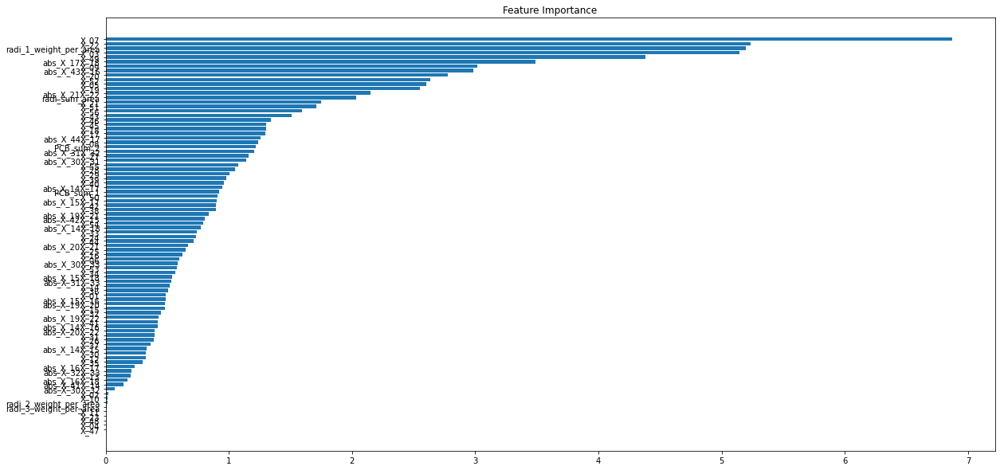

In [ ]:

feature_importance = model_set_cat[0].feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(20, 10))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(train_x.columns)[sorted_idx])
plt.title('Feature Importance')


In [ ]:
lis = []
for i in range(0,14):
  print(i)
  lis.append(model_set[i].feature_importances_)
lis


0
1
2
3
4
5
6
7
8
9
10
11
12
13


[array([0.97519561, 0.19920481, 4.61640594, 0.        , 3.23526566,
        1.54036572, 6.50614431, 2.5924501 , 4.73470326, 0.01594494,
        0.01757435, 0.59814125, 1.62812063, 1.08665871, 1.04347066,
        1.02528173, 1.42182587, 1.71253138, 3.78636336, 2.28244767,
        2.64994454, 5.85797882, 0.        , 0.69712353, 1.33286529,
        1.06549948, 1.07476848, 1.11165866, 1.38724982, 1.19363488,
        1.96758265, 0.78436626, 1.75857437, 1.45977775, 0.88474572,
        1.10357944, 1.00402479, 1.64646325, 1.14895713, 0.99170093,
        0.95979617, 1.49425829, 2.76319659, 1.30326265, 1.48094258,
        0.95246464, 0.        , 0.        , 5.3470873 , 2.13689592,
        2.67740204, 3.34302685, 2.34304382, 2.24731422, 2.05845567,
        2.75426153]),
 array([8.42065622e-01, 4.38392931e-01, 5.04246601e+00, 0.00000000e+00,
        3.80371673e+00, 8.29534266e-01, 5.57029892e+00, 2.46374829e+00,
        4.36543780e+00, 4.63725731e-03, 1.42354423e-02, 1.40315590e+00,
        2.6103

In [ ]:
pd.DataFrame(lis, columns = ["x_"+str(i) for i in range(0,56)]).to_csv("catboost_feature_importance_0813.csv", index =False)

In [ ]:
train_x 

,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,X_10,...,X_47,X_48,X_49,X_50,X_51,X_52,X_53,X_54,X_55,X_56
0,70.544,103.320,67.47,1,101.892,74.983,29.45,62.38,245.71,0.0,...,1,1,9706.03,137.043591,135.359219,147.837968,134.313475,125.605427,136.721425,125.028256
1,69.524,103.321,65.17,1,101.944,72.943,28.73,61.23,233.61,0.0,...,1,1,10423.43,133.736691,135.979817,149.924692,123.630583,127.893337,143.322659,124.877308
2,72.583,103.320,64.07,1,103.153,72.943,28.81,105.77,272.20,0.0,...,1,1,10948.53,132.805112,131.055355,146.814592,128.939070,127.012195,140.395688,122.238232
3,71.563,103.320,67.57,1,101.971,77.022,28.92,115.21,255.36,0.0,...,1,1,15007.03,134.138760,133.239422,139.720132,132.260824,130.723186,147.624829,134.875225
4,69.524,103.320,63.57,1,101.981,70.904,29.68,103.38,241.46,0.0,...,1,1,11051.03,142.728970,136.620022,134.853555,134.760252,125.647793,139.331105,123.272762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39602,66.465,103.320,62.27,1,103.150,66.825,30.20,77.83,298.05,0.0,...,1,1,60630.73,129.965741,130.807148,133.481737,125.273130,121.780933,133.780110,129.029812
39603,66.465,103.321,62.77,1,102.021,66.825,29.21,102.25,270.67,0.0,...,1,1,60763.43,127.633885,120.158764,142.667802,122.465490,122.987209,143.090741,122.811413
39604,68.504,103.320,64.67,1,103.144,68.864,29.96,102.61,198.07,0.0,...,1,1,8813.33,132.501286,136.893025,134.419328,129.115431,130.920147,140.489232,119.166699
39605,66.465,103.320,63.67,1,102.025,67.845,30.30,112.60,275.52,0.0,...,1,1,62222.33,128.189679,121.495930,141.288011,130.141676,125.518825,136.603634,124.525929
